# Multi-experiment IHC File Summary
## General Imports and Setup

In [48]:
# base and metaprogramming imports
from __future__ import annotations

import datetime
import os
import shutil
import sys
import itertools as it
import pprint as pp
import time
from typing import Optional
import warnings
import glob
import copy

# analysis imports
import h5py
import numpy as np
import pandas as pd
import pandas
import yaml
from pandas.api.types import CategoricalDtype
import scipy
import scipy.ndimage
import skimage as ski
from tifffile.tifffile import imwrite
import PIL

import ants
try:
    ants.from_numpy
except Exception:
    warnings.warn(f'`ants` module import failed.')
    ants = None
else:
    print('`ants` installed and imported successfully.')

# visualization imports
import napari
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar

import seaborn as sns

# ipynb-specific imports
try:
    import ipynbname
except Exception as e:
    warnings.warn(f'`ipynbname` module import failed with error: {e!r}')
    ipynbname = None
    
if ipynbname is not None:
    _file = ipynbname.path()
else:
    # manually set the full path to the current notebook below if `ipynbname` 
    # import fails
    _file = ''
    
jobs_dir = os.path.split(_file)[0]
sources_dir = os.path.abspath(os.path.join(jobs_dir, '..'))
repo_dir = os.path.abspath(os.path.join(sources_dir, '..'))
config_dir = os.path.abspath(os.path.join(repo_dir, 'configs'))

# add sources directory to path
if sources_dir not in sys.path:
    sys.path.append(sources_dir)

# local imports
import c_swain_python_utils as csutils
from utilities import *
import imaging_dataset as imd
import prairie_view_imports as pvi

# caiman imports
import bokeh.plotting as bpl
import cv2
try:
    cv2.setNumThreads(0)
except Exception:
    pass
import caiman as cm
from caiman.motion_correction import MotionCorrect
from caiman.source_extraction.cnmf import cnmf as cnmf
from caiman.source_extraction.cnmf import params as params
from caiman.utils.utils import download_demo
from caiman.utils.visualization import plot_contours, nb_view_patches, nb_plot_contour
bpl.output_notebook()


_basename = os.path.basename(_file)
_name = csutils.no_ext_basename(_file)

`ants` installed and imported successfully.


Loading BokehJS ...

### Plotting Defaults

In [23]:
mpl.font_manager.fontManager.addfont('C:\\Windows\\Fonts\\Linotype - HelveticaLTPro-Black.otf')
mpl.font_manager.fontManager.addfont('C:\\Windows\\Fonts\\Linotype - HelveticaLTPro-Bold.otf')
mpl.font_manager.fontManager.addfont('C:\\Windows\\Fonts\\Linotype - HelveticaLTPro-Roman.otf')
sns.set_style(
    'ticks',
    {'font.sans-serif': ['Helvetica LT Pro', ],
     'mathtext.fontset': ['cm',],
     'axes.linewidth': 2,
     }
)
axes_lw = 2
mpl.rcParams['axes.linewidth'] = axes_lw
mpl.rcParams['xtick.major.width'] = axes_lw
mpl.rcParams['xtick.minor.width'] = axes_lw
mpl.rcParams['ytick.major.width'] = axes_lw
mpl.rcParams['ytick.minor.width'] = axes_lw

### Logging Setup

In [24]:
# logging setup
log = csutils.get_logger(_name)

debug_mode = False
default_window_level = 'debug'

log_path = os.path.join(sources_dir, '..', 'logs', f'{_basename}.log')
csutils.apply_standard_logging_config(
    file_path=log_path,
    window_level='debug' if debug_mode else default_window_level,
    window_format='debug' if debug_mode else 'default')

## File Information

In [25]:
input_image_dir = (
    r'G:\c_swain\zf_correlative_microscopy\analyzed_and_generated_data'
    r'\multi_experiment_figures\ihc_protocol_gcamp_summary')

input_image_file_paths = glob.glob(os.path.join(input_image_dir, '*.tif'))

log.info('Identified the following image files:')
[log.info('{:d}: {:s}', i+1, f) for i, f in enumerate(input_image_files)];

local-nb_cs-ii-[multi]_ihc_file_prep (   7): INFO : Identified the following image files:
local-nb_cs-ii-[multi]_ihc_file_prep (   8): INFO : 1: G:\c_swain\zf_correlative_microscopy\analyzed_and_generated_data\multi_experiment_figures\ihc_protocol_gcamp_summary\cs-i-82_fish_a.tif
local-nb_cs-ii-[multi]_ihc_file_prep (   8): INFO : 2: G:\c_swain\zf_correlative_microscopy\analyzed_and_generated_data\multi_experiment_figures\ihc_protocol_gcamp_summary\cs-i-82_fish_c_003.tif
local-nb_cs-ii-[multi]_ihc_file_prep (   8): INFO : 3: G:\c_swain\zf_correlative_microscopy\analyzed_and_generated_data\multi_experiment_figures\ihc_protocol_gcamp_summary\cs-ii-07-B1_multi-channel-stack_012.tif
local-nb_cs-ii-[multi]_ihc_file_prep (   8): INFO : 4: G:\c_swain\zf_correlative_microscopy\analyzed_and_generated_data\multi_experiment_figures\ihc_protocol_gcamp_summary\cs-ii-29_fish-C2_eval-stack_6-pos_10-z_4-chan_014-1.tif
local-nb_cs-ii-[multi]_ihc_file_prep (   8): INFO : 5: G:\c_swain\zf_correlative_mic

## Loading In Images

In [26]:
X_RESOLUTION_INT_KEY = 282
X_RESOLUTION_KEY = 'pixels_per_micron'

metadata_dict: dict[str, dict] = dict()
input_image_dict: dict[str, np.ndarray] = dict()
basename_dict = dict()
for image_path in input_image_file_paths:
    image = imread(image_path)
    input_image_dict[image_path] = image
    log.info('Loaded image from {:s}', image_path)
    log.info('Image shape: {:s}', str(image.shape))

    basename = csutils.no_ext_basename(image_path)
    basename_dict[image_path] = basename

    metadata_dict[image_path] = dict()
    try:
        img = PIL.Image.open(image_path)
        exif_data = img.getexif()
        metadata_dict[image_path] = {
            X_RESOLUTION_KEY: exif_data[X_RESOLUTION_INT_KEY]
        }
    except Exception as e:
        log.warning(
            'Failed to extract metadata from {:s}',
            image_path, exc_info=e)

pp.pprint(metadata_dict)

PIL.TiffImagePlugin (1052): DEBUG : *** TiffImageFile._open ***
PIL.TiffImagePlugin (1053): DEBUG : - __first: 8
PIL.TiffImagePlugin (1054): DEBUG : - ifh: b'MM\x00*\x00\x00\x00\x08'
PIL.TiffImagePlugin (1090): DEBUG : Seeking to frame 0, on frame -1, __next 8, location: 8
PIL.TiffImagePlugin (1096): DEBUG : Loading tags, location: 8
PIL.TiffImagePlugin ( 815): DEBUG : tag: NewSubfileType (254) - type: long (4) - value: b'\x00\x00\x00\x00'
PIL.TiffImagePlugin ( 815): DEBUG : tag: ImageWidth (256) - type: long (4) - value: b'\x00\x00\x16g'
PIL.TiffImagePlugin ( 815): DEBUG : tag: ImageLength (257) - type: long (4) - value: b'\x00\x00\x0f4'
PIL.TiffImagePlugin ( 815): DEBUG : tag: BitsPerSample (258) - type: short (3) - value: b'\x00\x10'
PIL.TiffImagePlugin ( 815): DEBUG : tag: Compression (259) - type: short (3) - value: b'\x00\x01'
PIL.TiffImagePlugin ( 815): DEBUG : tag: PhotometricInterpretation (262) - type: short (3) - value: b'\x00\x01'
PIL.TiffImagePlugin ( 815): DEBUG : tag: Im

In [77]:

X_SIZE_MICRON_KEY = 'x_size_micron'
Y_SIZE_MICRON_KEY = 'y_size_micron'
IMAGE_LIMS_KEY = 'image_lims'
ASPECT_RATIO_KEY = 'aspect_ratio'

for image_path, image in input_image_dict.items():
    metadata = metadata_dict[image_path]
    pixels_per_micron = metadata[X_RESOLUTION_KEY]
    pixel_pitch = 1.0 / pixels_per_micron
    half_pitch = pixel_pitch / 2.0

    _, y_shape, x_shape = tuple(image.shape)

    x_size = x_shape * pixel_pitch
    y_size = y_shape * pixel_pitch
    metadata[X_SIZE_MICRON_KEY] = x_size
    metadata[Y_SIZE_MICRON_KEY] = y_size
    metadata[ASPECT_RATIO_KEY] = y_size / x_size
    metadata[IMAGE_LIMS_KEY] = (
        0 - half_pitch, x_size - half_pitch,
        0 - half_pitch, y_size - half_pitch)

pp.pprint(metadata_dict)

{'G:\\c_swain\\zf_correlative_microscopy\\analyzed_and_generated_data\\multi_experiment_figures\\ihc_protocol_gcamp_summary\\cs-i-82_fish_a.tif': {'aspect_ratio': 0.6786399302528334,
                                                                                                                                                   'image_lims': (-0.08581940713207332,
                                                                                                                                                                  984.262780397749,
                                                                                                                                                                  -0.08581940713207332,
                                                                                                                                                                  667.9324457089267),
                                                                                       

### `imshow` Settings

In [156]:
max_pcttile = 99.5
min_pcttile = 15
cmap = 'cividis'

inset_size_micron = 80
inset_aspect_ratio = 1.0

fig_height = 2
fig_aspect = 2.8/2.0

# computed
fig_width = fig_height * fig_aspect

### Log Manual Annotation Notes

In [159]:
figure_letters =     {
    'fich_cs-ii-02-C3_004_CORRECTED': 'E',
    'csi-ii-14_fish-14a_z-6_c-4_012': 'C',
    'cs-ii-34-b1_640-large-im-test006': 'A',
    'cs-ii-29_fish-C2_eval-stack_6-pos_10-z_4-chan_014-1': 'B',
    'cs-ii-07-B1_multi-channel-stack_012': 'D',
    'cs-i-82_fish_c_003': 'F',
    'cs-i-82_fish_a': 'G',
}

crop_top_left_bottom_dict = {
    'fich_cs-ii-02-C3_004_CORRECTED': (646, 12, 36),
    'csi-ii-14_fish-14a_z-6_c-4_012': (650, None, 10),
    'cs-ii-34-b1_640-large-im-test006': (1156, 157, 75),
    'cs-ii-29_fish-C2_eval-stack_6-pos_10-z_4-chan_014-1': (632, 57, 50),
    'cs-ii-07-B1_multi-channel-stack_012': (660, None, None),
    'cs-i-82_fish_c_003': (638, 38, None),
    'cs-i-82_fish_a': (None, 35, None),
}

zoom_location_dict_xy_plane = {
    'fich_cs-ii-02-C3_004_CORRECTED': ((124, 1132), 19),
    'csi-ii-14_fish-14a_z-6_c-4_012': ((348, 1120), 3),
    'cs-ii-34-b1_640-large-im-test006': ((1248, 2250), 2),
    'cs-ii-29_fish-C2_eval-stack_6-pos_10-z_4-chan_014-1': ((548, 1271), 5),
    'cs-ii-07-B1_multi-channel-stack_012': ((532, 1304), 6),
    'cs-i-82_fish_c_003': ((672, 1368), 8),
    'cs-i-82_fish_a': ((528, 1404), 13),
}

deep_plane_dict_z = {
    'fich_cs-ii-02-C3_004_CORRECTED': 22,
    'csi-ii-14_fish-14a_z-6_c-4_012': 6,
    'cs-ii-34-b1_640-large-im-test006': 7,
    'cs-ii-29_fish-C2_eval-stack_6-pos_10-z_4-chan_014-1': 7,
    'cs-ii-07-B1_multi-channel-stack_012': 11,
    'cs-i-82_fish_c_003': 14,
    'cs-i-82_fish_a': 19,
}

## Preview Images

matplotlib.pyplot ( 414): DEBUG : Loaded backend module://matplotlib_inline.backend_inline version unknown.


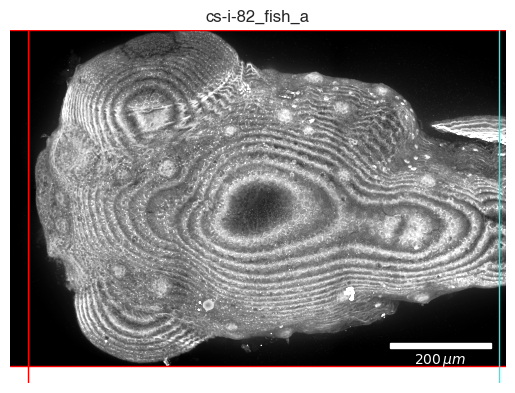

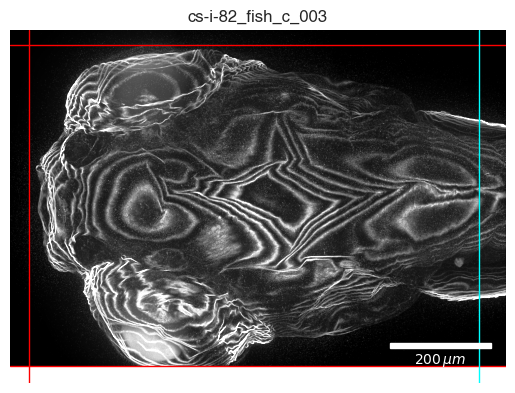

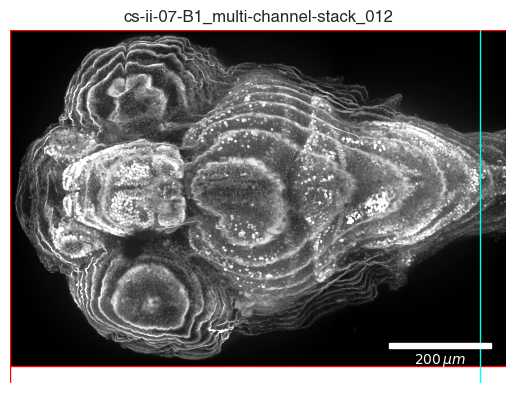

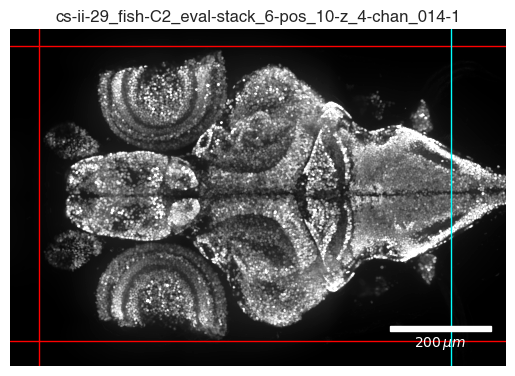

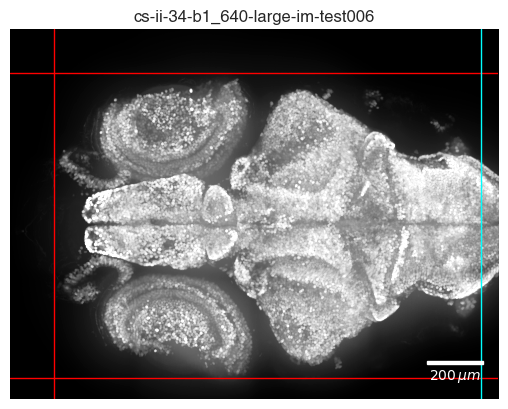

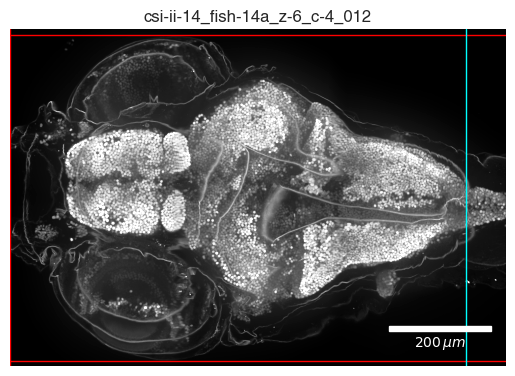

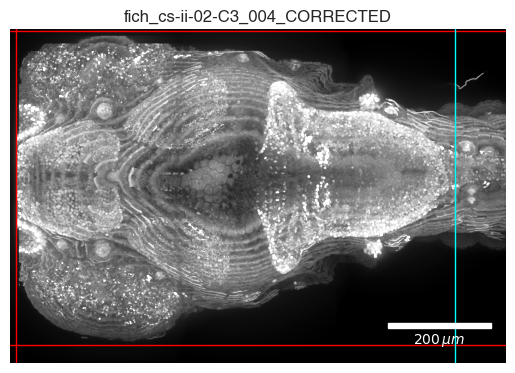

In [174]:
%matplotlib inline
for image_path, image in input_image_dict.items():
    metadata = metadata_dict[image_path]

    mip = np.max(image, axis=0)
    min_val = np.percentile(mip, 10)
    max_val = np.percentile(mip, 99)

    plt.figure()
    plt.imshow(
        mip,
        cmap='Greys_r',
        clim=(min_val, max_val),
        extent=metadata[IMAGE_LIMS_KEY],
        origin='lower')
    plt.title(basename_dict[image_path])
    plt.axis('off')

    scalebar = AnchoredSizeBar(
        transform=plt.gca().transData,
        size=200,
        label='$200\,{\mu}m$',
        loc='lower right',
        pad=1,
        color='white',
        frameon=False,
        size_vertical=10,
        fontproperties={'weight': 'bold'})

    basename = basename_dict[image_path]

    top, left, bottom = crop_top_left_bottom_dict[basename]

    top = metadata[Y_SIZE_MICRON_KEY] if top is None else top
    left = 0 if left is None else left
    bottom = 0 if bottom is None else bottom

    original_bottom = bottom
    original_top = top
    top = metadata[Y_SIZE_MICRON_KEY] - original_bottom
    bottom = metadata[Y_SIZE_MICRON_KEY] - original_top

    plt.axhline(top, color='r', lw=1)
    plt.axvline(left, color='r', lw=1)
    plt.axhline(bottom, color='r', lw=1)

    right = (top - bottom) * fig_aspect + left
    plt.axvline(right, color='cyan', lw=1)

    plt.gca().invert_yaxis()

    plt.gca().add_artist(scalebar)
    plt.show()
    time.sleep(0.1)

## Generate Maximum Intensity Projections

### Generate MIPs

In [131]:
mip_dict: dict[str, np.ndarray] = dict()
for image_path, image in input_image_dict.items():
    basename = basename_dict[image_path]
    mip = np.max(image, axis=0)
    mip_dict[image_path] = mip
    log.info('Generated MIP for {:s}', basename)
    log.info('MIP shape: {:s}', str(mip.shape))

local-nb_cs-ii-[multi]_ihc_file_prep (   6): INFO : Generated MIP for cs-i-82_fish_a
local-nb_cs-ii-[multi]_ihc_file_prep (   7): INFO : MIP shape: (3892, 5735)
local-nb_cs-ii-[multi]_ihc_file_prep (   6): INFO : Generated MIP for cs-i-82_fish_c_003
local-nb_cs-ii-[multi]_ihc_file_prep (   7): INFO : MIP shape: (3892, 5735)
local-nb_cs-ii-[multi]_ihc_file_prep (   6): INFO : Generated MIP for cs-ii-07-B1_multi-channel-stack_012
local-nb_cs-ii-[multi]_ihc_file_prep (   7): INFO : MIP shape: (3892, 5735)
local-nb_cs-ii-[multi]_ihc_file_prep (   6): INFO : Generated MIP for cs-ii-29_fish-C2_eval-stack_6-pos_10-z_4-chan_014-1
local-nb_cs-ii-[multi]_ihc_file_prep (   7): INFO : MIP shape: (3892, 5735)
local-nb_cs-ii-[multi]_ihc_file_prep (   6): INFO : Generated MIP for cs-ii-34-b1_640-large-im-test006
local-nb_cs-ii-[multi]_ihc_file_prep (   7): INFO : MIP shape: (5735, 7578)
local-nb_cs-ii-[multi]_ihc_file_prep (   6): INFO : Generated MIP for csi-ii-14_fish-14a_z-6_c-4_012
local-nb_cs-ii

### Plot MIPs

In [178]:
def subfigs_plot_mip(subfig_num=1):
    for image_path, mip in mip_dict.items():
        metadata = metadata_dict[image_path]
        basename = basename_dict[image_path]

        max_clip = np.percentile(mip, max_pcttile)
        min_clip = np.percentile(mip, min_pcttile)

        fig, ax = plt.subplots(
            1, 1,
            figsize=(fig_width, fig_height),
            gridspec_kw=dict(
                top=1, bottom=0,
                left=0, right=1),
            dpi=300,
            facecolor=None,
            edgecolor=None,
            frameon=False,)
        ax.imshow(
            mip,
            cmap='cividis',
            clim=(min_clip, max_clip),
            extent=metadata[IMAGE_LIMS_KEY],
            origin='lower')
        ax.axis('off')
        scalebar = AnchoredSizeBar(
            transform=ax.transData,
            size=200,
            sep=0,
            label_top=True,
            label='',
            loc='lower right',
            pad=1,
            color='white',
            frameon=False,
            size_vertical=10,
            fontproperties={'weight': 'bold'})
        ax.add_artist(scalebar)
        ax.text(
            0.01, 0.98,
            f'{figure_letters[basename]}{subfig_num:d}',
            transform=ax.transAxes,
            fontsize=10,
            color='white',
            ha='left',
            va='top',
            weight='black')

        top, left, bottom = crop_top_left_bottom_dict[basename]
        top = metadata[Y_SIZE_MICRON_KEY] if top is None else top
        left = 0 if left is None else left
        bottom = 0 if bottom is None else bottom
        right = ((top - bottom) * fig_aspect) + left

        original_bottom = bottom
        original_top = top
        top = metadata[Y_SIZE_MICRON_KEY] - original_bottom
        bottom = metadata[Y_SIZE_MICRON_KEY] - original_top

        (zoom_x, zoom_y), _ = zoom_location_dict_xy_plane[basename]

        pixel_pitch = 1.0 / metadata[X_RESOLUTION_KEY]

        zoom_x = pixel_pitch * zoom_x
        zoom_y = pixel_pitch * zoom_y

        square_patch = mpl.patches.Rectangle(
            (zoom_x, zoom_y),
            inset_size_micron,
            inset_size_micron,
            edgecolor='w',
            facecolor='none',
            lw=0.5,
            zorder=10,
            transform=ax.transData)
        ax.add_artist(square_patch)
        # ax.plot([zoom_x], [zoom_y], 'ro', ms=5, zorder=10)

        ax.set(
            xlim=(left, right),
            ylim=(top, bottom)
        )

        yield f'{basename}_mip', fig

subfig_generator = subfigs_plot_mip()

matplotlib.pyplot ( 414): DEBUG : Loaded backend module://matplotlib_inline.backend_inline version unknown.


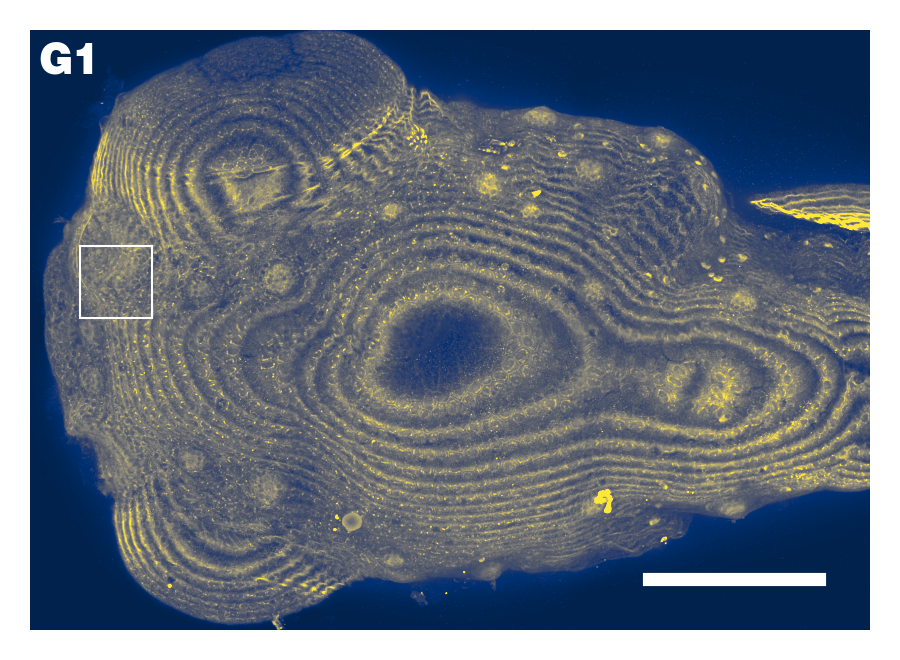

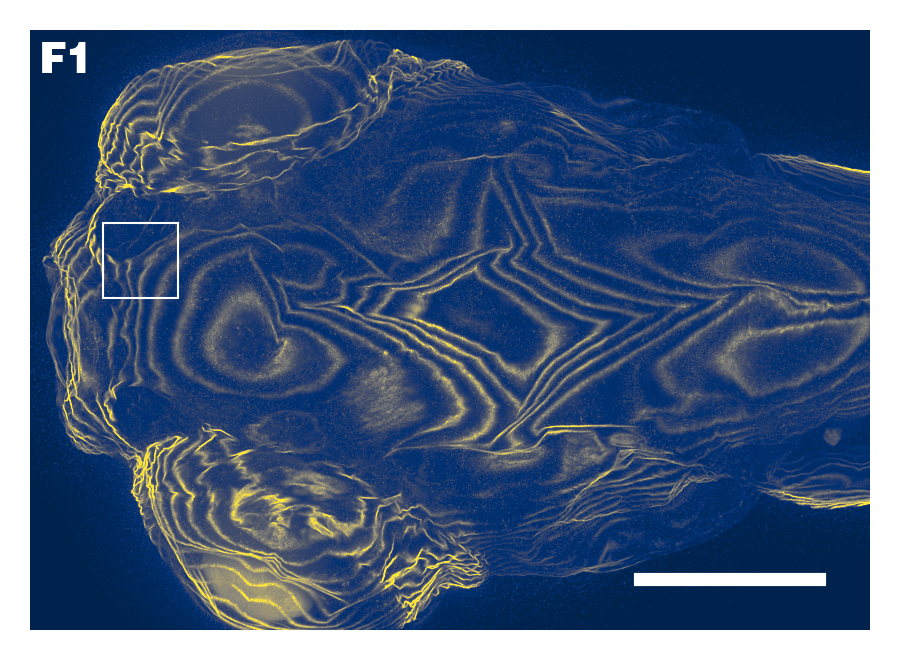

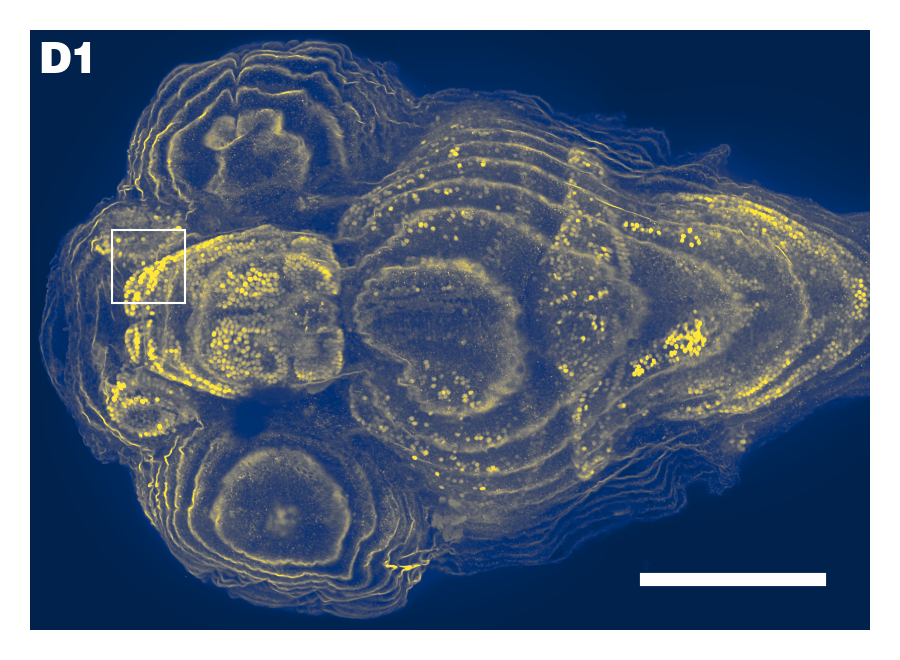

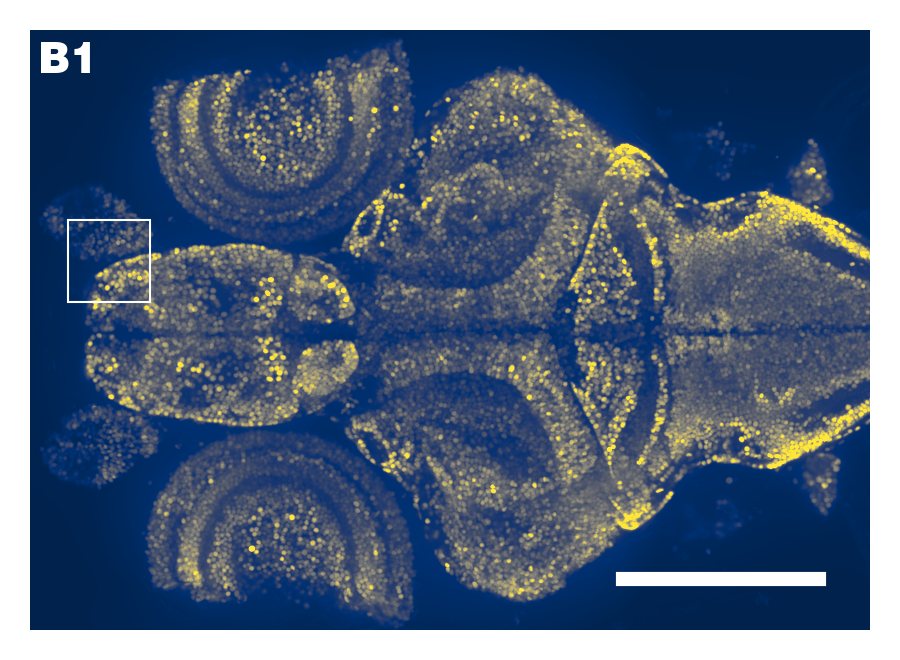

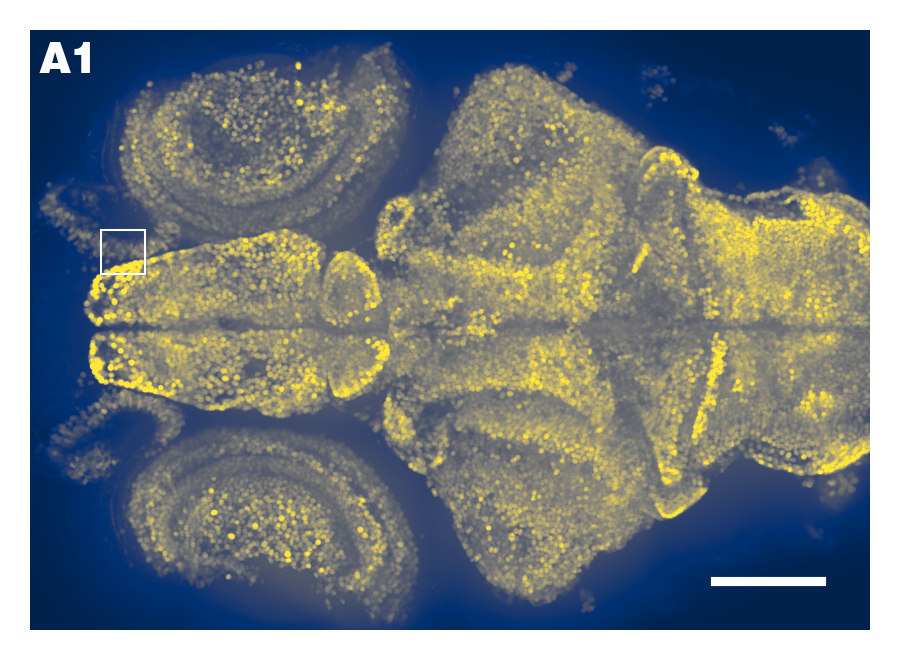

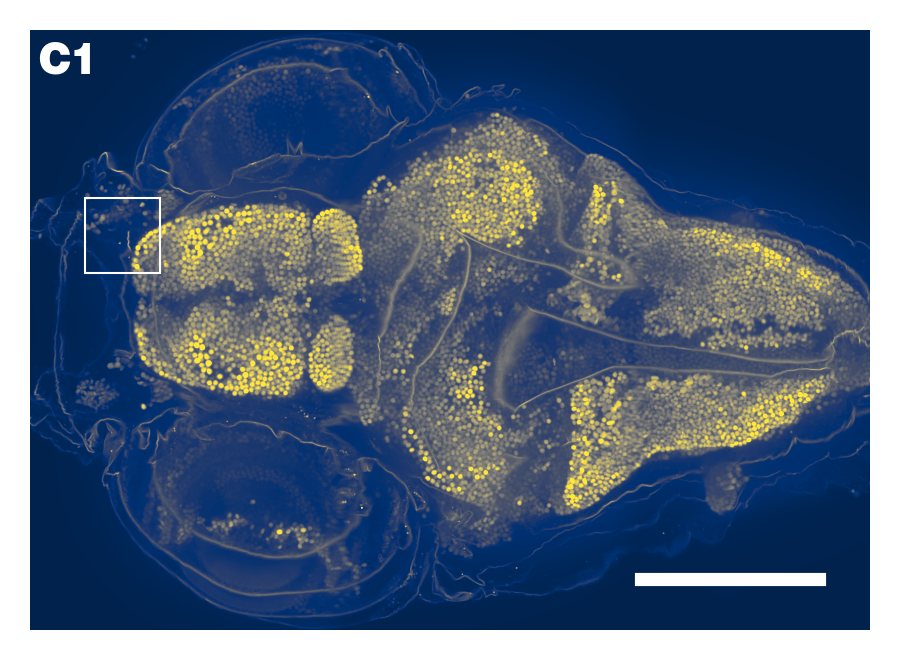

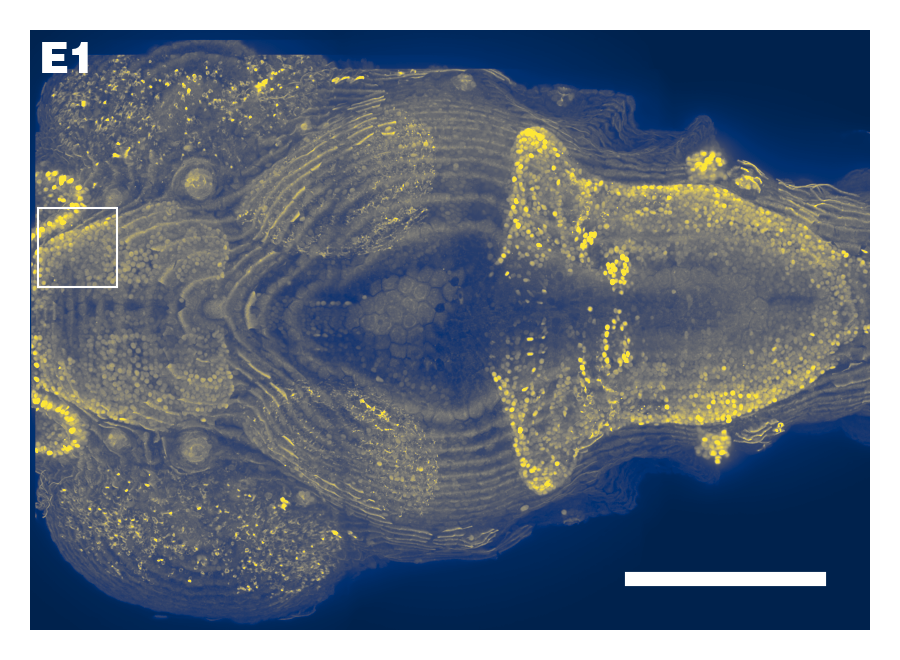

In [170]:
%matplotlib inline
for _ in subfig_generator:
    pass

## Generate Slice and Zoom View
### Generate Slice Views

In [179]:
def subfigs_slice_deep(subfig_num=2):
    for image_path, image in input_image_dict.items():
        basename = basename_dict[image_path]
        metadata = metadata_dict[image_path]

        slice_index = deep_plane_dict_z[basename] - 1

        slice_image = image[slice_index]

        min_clip = np.percentile(slice_image, min_pcttile)
        max_clip = np.percentile(slice_image, max_pcttile)

        fig, ax = plt.subplots(
            1, 1,
            figsize=(fig_width, fig_height),
            gridspec_kw=dict(
                top=1, bottom=0,
                left=0, right=1),
            dpi=300,
            facecolor=None,
            edgecolor=None,
            frameon=False,)
        ax.imshow(
            slice_image,
            cmap='cividis',
            clim=(min_clip, max_clip),
            extent=metadata[IMAGE_LIMS_KEY],
            origin='lower')
        ax.axis('off')
        scalebar = AnchoredSizeBar(
            transform=ax.transData,
            size=200,
            sep=0,
            label_top=True,
            label='',
            loc='lower right',
            pad=1,
            color='white',
            frameon=False,
            size_vertical=10,
            fontproperties={'weight': 'bold'})
        ax.add_artist(scalebar)
        ax.text(
            0.01, 0.98,
            f'{figure_letters[basename]}{subfig_num:d}',
            transform=ax.transAxes,
            fontsize=10,
            color='white',
            ha='left',
            va='top',
            weight='black')

        top, left, bottom = crop_top_left_bottom_dict[basename]
        top = metadata[Y_SIZE_MICRON_KEY] if top is None else top
        left = 0 if left is None else left
        bottom = 0 if bottom is None else bottom

        original_bottom = bottom
        original_top = top
        top = metadata[Y_SIZE_MICRON_KEY] - original_bottom
        bottom = metadata[Y_SIZE_MICRON_KEY] - original_top

        right = ((top - bottom) * fig_aspect) + left

        ax.set(
            xlim=(left, right),
            ylim=(top, bottom)
        )

        yield f'{basename}_deep_slice', fig

subfig_generator = subfigs_slice_deep()

matplotlib.pyplot ( 414): DEBUG : Loaded backend module://matplotlib_inline.backend_inline version unknown.


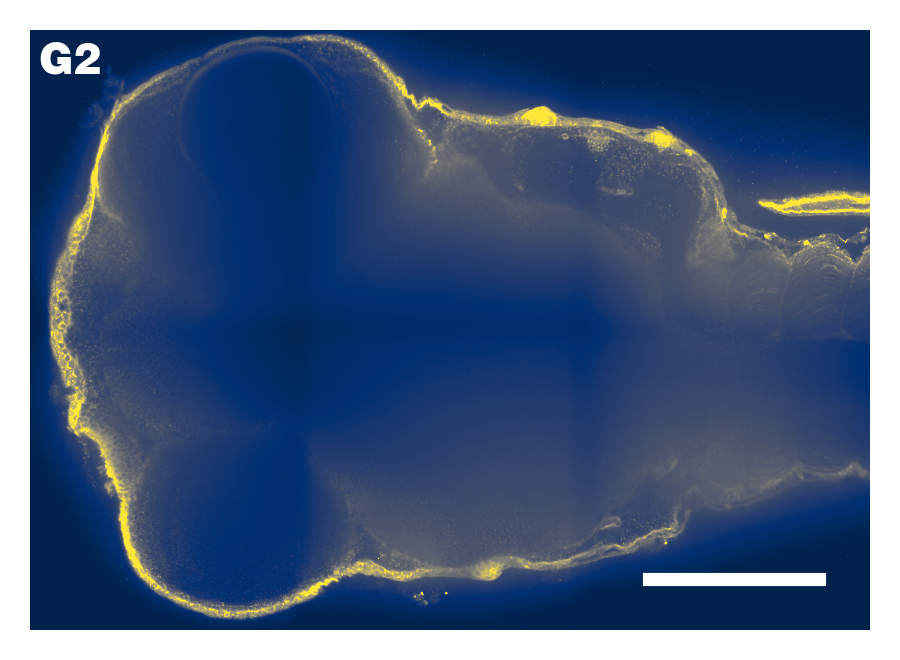

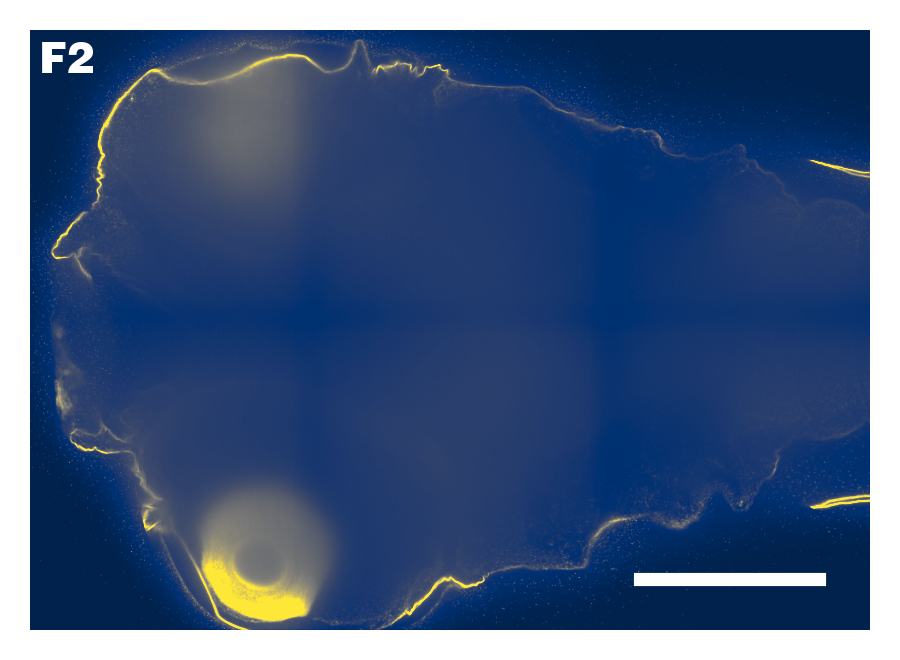

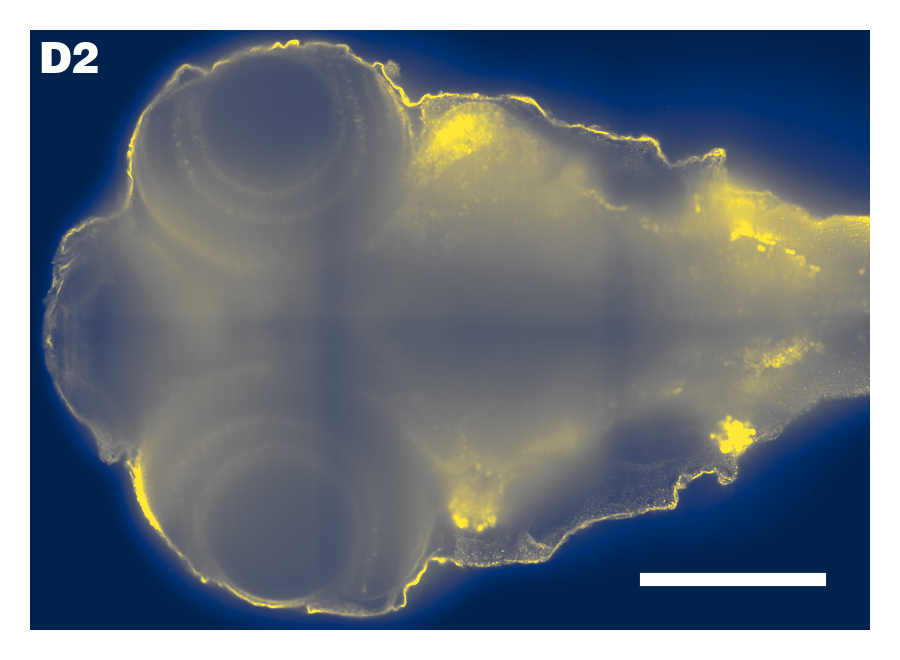

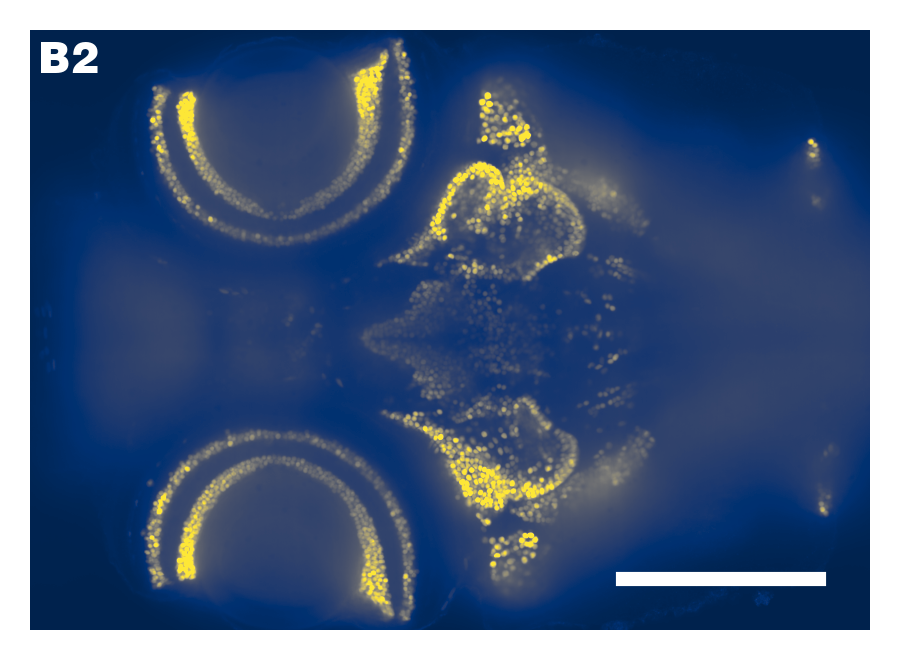

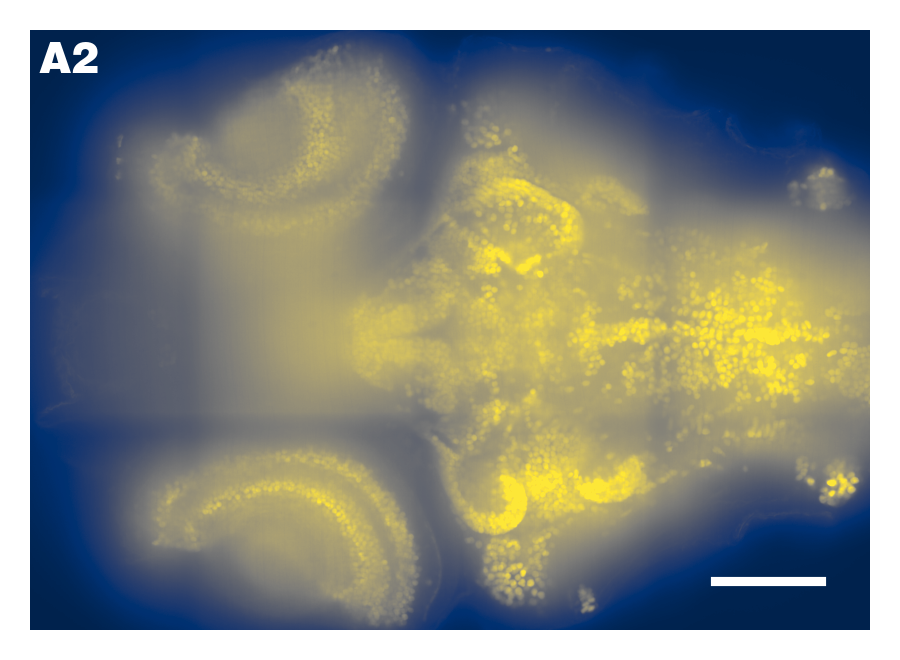

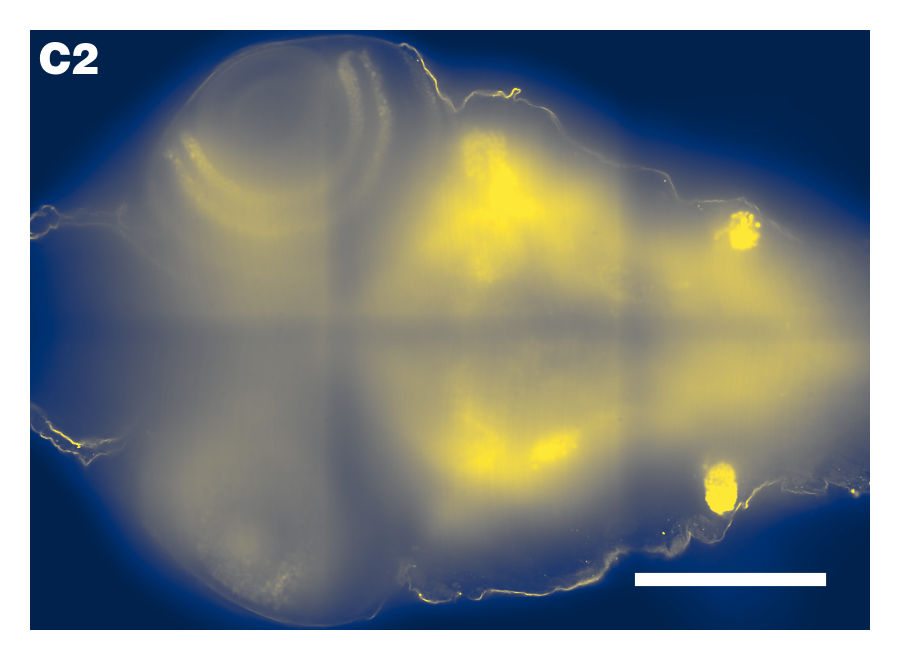

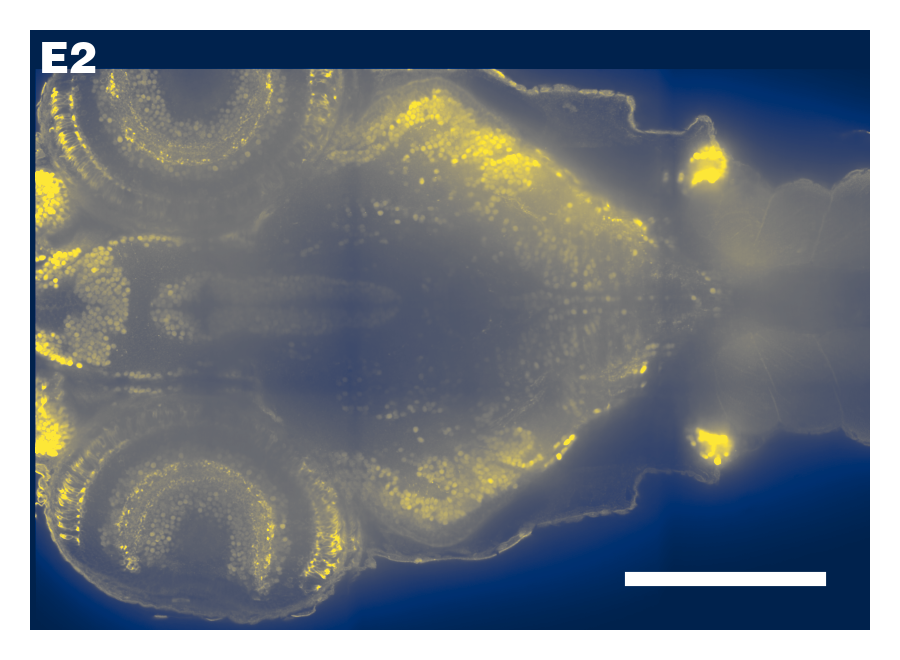

In [168]:
%matplotlib inline
for _ in subfig_generator:
    pass

### Generate Zoom Views

In [180]:
def subfigs_zoom(subfig_num=3):
    for image_path, image in input_image_dict.items():
        basename = basename_dict[image_path]
        metadata = metadata_dict[image_path]

        (zoom_x, zoom_y), slice_index = zoom_location_dict_xy_plane[basename]
        slice_index = slice_index - 1

        slice_image = image[slice_index]

        pixel_pitch = 1.0 / metadata[X_RESOLUTION_KEY]
        inset_size_pixels = int(inset_size_micron / pixel_pitch)

        zoom_selection = slice_image[
            zoom_y:zoom_y+inset_size_pixels,
            zoom_x:zoom_x+inset_size_pixels]
        min_clip = np.percentile(zoom_selection, min_pcttile/2)
        max_clip = np.percentile(zoom_selection, max_pcttile)

        fig, ax = plt.subplots(
            1, 1,
            figsize=(fig_height, fig_height),
            gridspec_kw=dict(
                top=1, bottom=0,
                left=0, right=1),
            dpi=300,
            facecolor=None,
            edgecolor=None,
            frameon=False,)
        ax.imshow(
            slice_image,
            cmap='cividis',
            clim=(min_clip, max_clip),
            extent=metadata[IMAGE_LIMS_KEY],
            origin='lower')
        ax.axis('off')
        scalebar = AnchoredSizeBar(
            transform=ax.transData,
            size=20,
            sep=0,
            label_top=True,
            label='',
            loc='lower right',
            pad=1,
            color='white',
            frameon=False,
            size_vertical=1,
            fontproperties={'weight': 'bold'})
        ax.add_artist(scalebar)
        ax.text(
            0.01, 0.98,
            f'{figure_letters[basename]}{subfig_num:d}',
            transform=ax.transAxes,
            fontsize=13,
            color='white',
            ha='left',
            va='top',
            weight='black')

        pixel_pitch = 1.0 / metadata[X_RESOLUTION_KEY]

        zoom_x = pixel_pitch * zoom_x
        zoom_y = pixel_pitch * zoom_y

        ax.set(
            xlim=(zoom_x, zoom_x + inset_size_micron),
            ylim=(zoom_y + inset_size_micron, zoom_y)
        )

        yield f'{basename}_zoom', fig

subfig_generator = subfigs_zoom()

matplotlib.pyplot ( 414): DEBUG : Loaded backend module://matplotlib_inline.backend_inline version unknown.


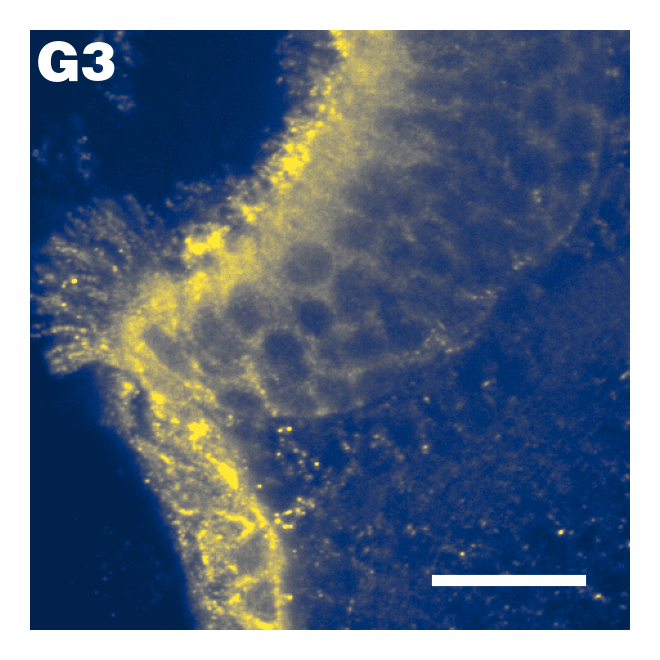

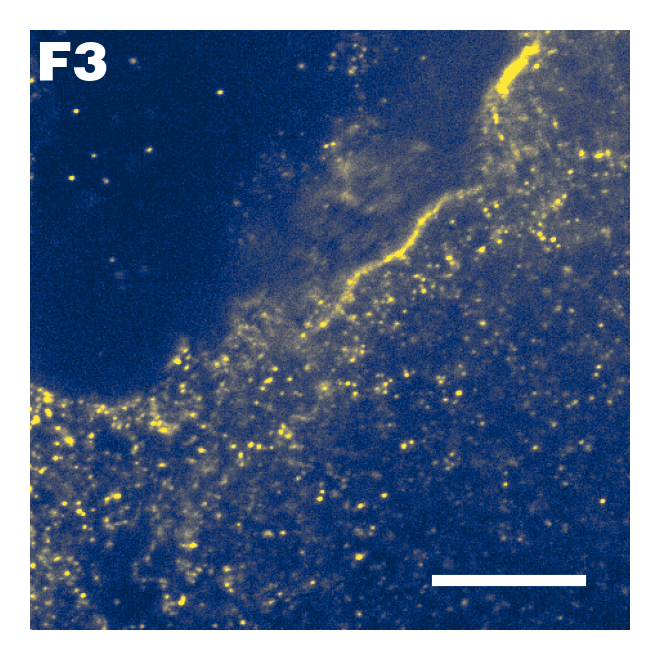

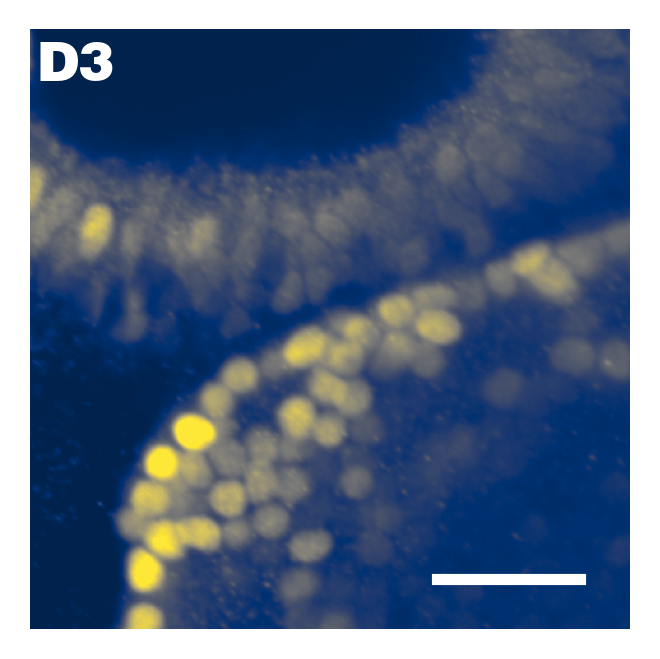

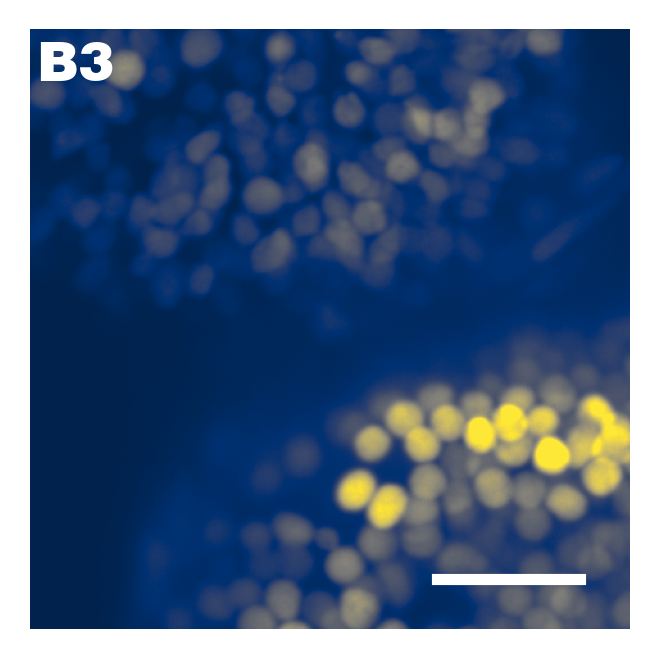

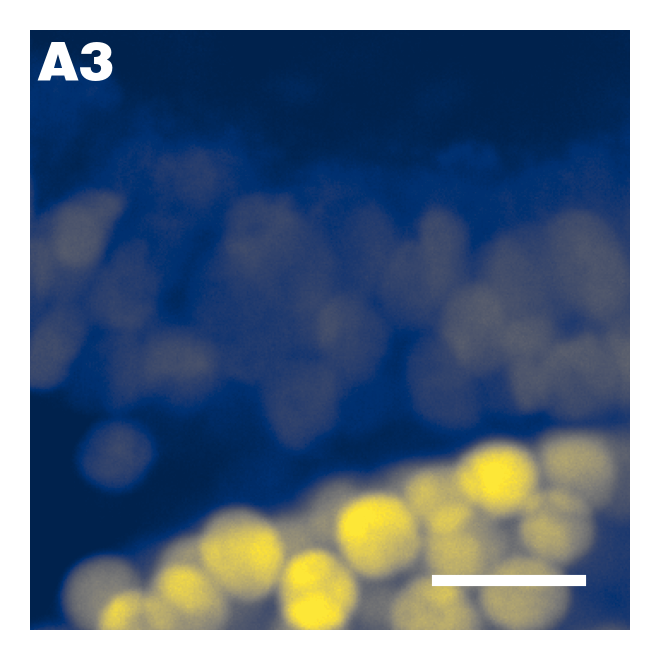

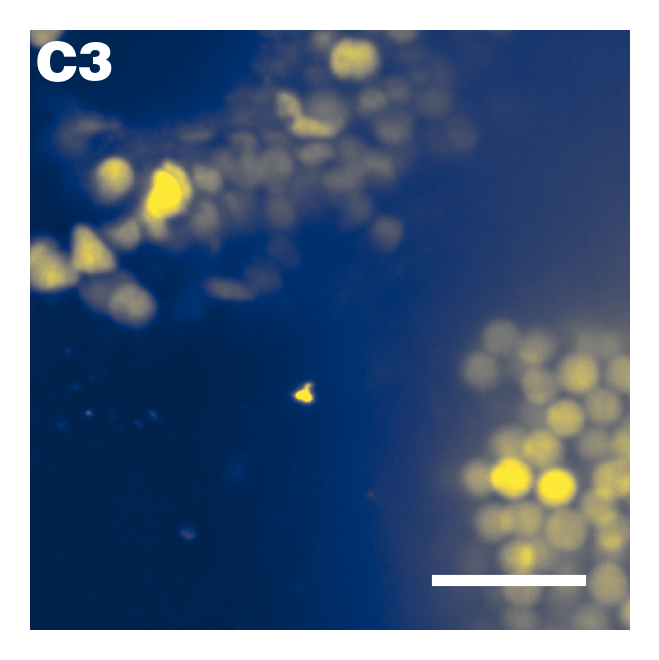

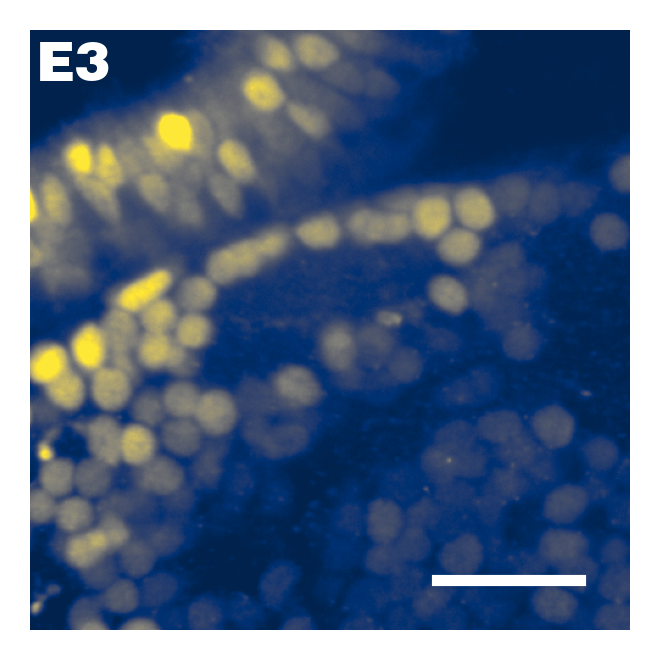

In [163]:
%matplotlib inline
for _ in subfig_generator:
    pass

## Save Figures

In [182]:
all_subfigs = it.chain(
    subfigs_plot_mip(),
    subfigs_slice_deep(),
    subfigs_zoom())

output_dir = os.path.join(input_image_dir, 'exported_figures')
csutils.touchdir(output_dir)

for fig_name, fig in all_subfigs:
    log.info('Saving figure {:s}.', fig_name)
    for ext in ('png', 'pdf'):
        fig_path = os.path.join(output_dir, f'{fig_name}.{ext}')
        fig.savefig(fig_path, dpi=300)
    plt.close(fig)

local-nb_cs-ii-[multi]_ihc_file_prep (  10): INFO : Saving figure cs-i-82_fish_a_mip.
matplotlib.backends.backend_pdf ( 918): DEBUG : Assigning font /F1 = 'C:\\Windows\\Fonts\\Linotype - HelveticaLTPro-Black.otf'
matplotlib.backends.backend_pdf ( 964): DEBUG : Embedding font C:\Windows\Fonts\Linotype - HelveticaLTPro-Black.otf.
matplotlib.backends.backend_pdf ( 971): DEBUG : Writing TrueType font.
local-nb_cs-ii-[multi]_ihc_file_prep (  10): INFO : Saving figure cs-i-82_fish_c_003_mip.
matplotlib.backends.backend_pdf ( 918): DEBUG : Assigning font /F1 = 'C:\\Windows\\Fonts\\Linotype - HelveticaLTPro-Black.otf'
matplotlib.backends.backend_pdf ( 964): DEBUG : Embedding font C:\Windows\Fonts\Linotype - HelveticaLTPro-Black.otf.
matplotlib.backends.backend_pdf ( 971): DEBUG : Writing TrueType font.
local-nb_cs-ii-[multi]_ihc_file_prep (  10): INFO : Saving figure cs-ii-07-B1_multi-channel-stack_012_mip.
matplotlib.backends.backend_pdf ( 918): DEBUG : Assigning font /F1 = 'C:\\Windows\\Font

# Multi Experiment Staining Target Figure

In [360]:
PERK_BY_TERK = 'perk_by_terk.tif'
PERK_FNAME = 'cs-ii-07-a_perk.tif'
TERK_FNAME = 'cs-ii-07-a_erk.tif'

figure_letters = {
    'cs-ii-07-a_erk.tif': 'F',
    'cs-ii-07-a_perk.tif': 'G',
    'cs-ii-21-a_oxt.tif': 'E',
    'cs-ii-33-b2_gaba.tif': 'D',
    'cs-ii-34-b1_gfp.tif': 'B',
    'cs-ii-34-b1_ser.tif': 'C',
    'cs-ii-34-b1_dapi.tif': 'A',
    PERK_BY_TERK: 'H',
}

input_image_dir = (
    r'G:\c_swain\zf_correlative_microscopy'
    r'\analyzed_and_generated_data\multi_experiment_figures'
    r'\staining_target_summary')

input_image_refs = {
    'cs-ii-07-a_erk.tif': 'cs-ii-07-a_dapi.tif',
    'cs-ii-07-a_perk.tif': 'cs-ii-07-a_dapi.tif',
    'cs-ii-21-a_oxt.tif': 'cs-ii-21-a_dapi.tif',
    'cs-ii-33-b2_gaba.tif': 'cs-ii-33-b2_dapi.tif',
    'cs-ii-34-b1_gfp.tif': 'cs-ii-34-b1_dapi.tif',
    'cs-ii-34-b1_ser.tif': 'cs-ii-34-b1_dapi.tif',
    'cs-ii-34-b1_dapi.tif': 'cs-ii-34-b1_dapi.tif',
    PERK_BY_TERK: 'cs-ii-07-a_dapi.tif',
}

crop_top_left_bottom_dict = {
    'cs-ii-07-a_dapi.tif': (None, 23, None),
    'cs-ii-21-a_dapi.tif': (None, 32, 600),
    'cs-ii-33-b2_dapi.tif': (55, 26, 636),
    'cs-ii-34-b1_dapi.tif': (136, None, 1283),
}

roi_loc_dict_xy_plane = {
    'cs-ii-07-a_dapi.tif': ((504, 1584), 7),
    'cs-ii-21-a_dapi.tif': ((1502, 1570), 4),
    'cs-ii-33-b2_dapi.tif': ((2466, 943), 2),
    'cs-ii-34-b1_dapi.tif': ((1924, 2543), 3),
}

roi_size_micron = 100

min_pcttile = 10
max_pcttile = 99.5
ref_mip_attenuation = 0.6

In [345]:
unique_image_refs = set(input_image_refs.values())
image_ref_dict = dict()
metadata_dict = dict()
for image_ref_name in unique_image_refs:
    image_ref_path = os.path.join(input_image_dir, image_ref_name)
    image_ref = imread(image_ref_path)
    image_ref_dict[image_ref_name] = image_ref
    metadata = dict()

    try:
        img = PIL.Image.open(image_ref_path)
        exif_data = img.getexif()
        metadata[X_RESOLUTION_KEY] = exif_data[X_RESOLUTION_INT_KEY]
    except Exception as e:
        log.error(
            'Failed to extract metadata from {:s}',
            image_ref_path, exc_info=e)
        raise

    metadata_dict[image_ref_name] = metadata

channel_image_dict = dict()
for input_image_name in input_image_refs.keys():
    channel_image_path = os.path.join(input_image_dir, input_image_name)
    if os.path.exists(channel_image_path):
        channel_image = imread(channel_image_path)
        channel_image_dict[input_image_name] = channel_image
    else:
        log.warning('Channel image not found at {:s}.', channel_image_path)

PIL.TiffImagePlugin (1052): DEBUG : *** TiffImageFile._open ***
PIL.TiffImagePlugin (1053): DEBUG : - __first: 8
PIL.TiffImagePlugin (1054): DEBUG : - ifh: b'MM\x00*\x00\x00\x00\x08'
PIL.TiffImagePlugin (1090): DEBUG : Seeking to frame 0, on frame -1, __next 8, location: 8
PIL.TiffImagePlugin (1096): DEBUG : Loading tags, location: 8
PIL.TiffImagePlugin ( 815): DEBUG : tag: NewSubfileType (254) - type: long (4) - value: b'\x00\x00\x00\x00'
PIL.TiffImagePlugin ( 815): DEBUG : tag: ImageWidth (256) - type: long (4) - value: b'\x00\x00\x1d\x9a'
PIL.TiffImagePlugin ( 815): DEBUG : tag: ImageLength (257) - type: long (4) - value: b'\x00\x00\x16g'
PIL.TiffImagePlugin ( 815): DEBUG : tag: BitsPerSample (258) - type: short (3) - value: b'\x00\x10'
PIL.TiffImagePlugin ( 815): DEBUG : tag: Compression (259) - type: short (3) - value: b'\x00\x01'
PIL.TiffImagePlugin ( 815): DEBUG : tag: PhotometricInterpretation (262) - type: short (3) - value: b'\x00\x01'
PIL.TiffImagePlugin ( 815): DEBUG : tag:

local-nb_cs-ii-[multi]_ihc_file_prep (  29): WARNING : Channel image not found at G:\c_swain\zf_correlative_microscopy\analyzed_and_generated_data\multi_experiment_figures\staining_target_summary\perk_by_terk.tif.


In [346]:
for image_ref_name, metadata in metadata_dict.items():
    pixels_per_micron = metadata[X_RESOLUTION_KEY]
    pixel_pitch = 1.0 / pixels_per_micron
    half_pitch = pixel_pitch / 2.0

    image_ref = image_ref_dict[image_ref_name]
    _, y_shape, x_shape = tuple(image_ref.shape)

    log.info(f'{image_ref_name = }')
    log.info(f'{x_shape = }, {y_shape = }')

    x_size = x_shape * pixel_pitch
    y_size = y_shape * pixel_pitch
    metadata[X_SIZE_MICRON_KEY] = x_size
    metadata[Y_SIZE_MICRON_KEY] = y_size
    metadata[ASPECT_RATIO_KEY] = y_size / x_size
    metadata[IMAGE_LIMS_KEY] = (
        0 - half_pitch, x_size - half_pitch,
        0 - half_pitch, y_size - half_pitch)

local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : image_ref_name = 'cs-ii-34-b1_dapi.tif'
local-nb_cs-ii-[multi]_ihc_file_prep (  10): INFO : x_shape = 7578, y_shape = 5735
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : image_ref_name = 'cs-ii-21-a_dapi.tif'
local-nb_cs-ii-[multi]_ihc_file_prep (  10): INFO : x_shape = 5940, y_shape = 3994
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : image_ref_name = 'cs-ii-33-b2_dapi.tif'
local-nb_cs-ii-[multi]_ihc_file_prep (  10): INFO : x_shape = 5735, y_shape = 3892
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : image_ref_name = 'cs-ii-07-a_dapi.tif'
local-nb_cs-ii-[multi]_ihc_file_prep (  10): INFO : x_shape = 5735, y_shape = 3892


In [351]:
pp.pprint(metadata_dict)

{'cs-ii-07-a_dapi.tif': {'aspect_ratio': 0.6786399302528335,
                         'image_lims': (-0.08500001360000217,
                                        974.8651559784248,
                                        -0.08500001360000217,
                                        661.5551058488169),
                         'pixels_per_micron': 5.882352,
                         'x_size_micron': 974.9501559920249,
                         'y_size_micron': 661.6401058624169},
 'cs-ii-21-a_dapi.tif': {'aspect_ratio': 0.6723905723905724,
                         'image_lims': (-0.08500001360000217,
                                        1009.7151615544258,
                                        -0.08500001360000217,
                                        678.8951086232173),
                         'pixels_per_micron': 5.882352,
                         'x_size_micron': 1009.8001615680258,
                         'y_size_micron': 678.9801086368174},
 'cs-ii-33-b2_dapi.tif': {'aspec

## Preview Image Refs

In [348]:
%matplotlib qt

for image_ref_name, image_ref in image_ref_dict.items():
    metadata = metadata_dict[image_ref_name]

    mip = np.max(image_ref, axis=0)
    min_val = np.percentile(mip, 10)
    max_val = np.percentile(mip, 99)
    log.info(f'{mip.shape = }')

    fig, ax = plt.subplots(
        1, 1,
        gridspec_kw=dict(
            top=0.95, bottom=0.01,
            left=0.01, right=0.99),
    )
    ax.imshow(
        mip,
        cmap='Greys_r',
        clim=(min_val, max_val),
        extent=metadata[IMAGE_LIMS_KEY],
        origin='lower')
    ax.set_title(image_ref_name)
    ax.axis('off')

    scalebar = AnchoredSizeBar(
        transform=plt.gca().transData,
        size=200,
        label='$\mathdefault{200\,{\mu}m}$',
        loc='lower right',
        pad=1,
        color='white',
        frameon=False,
        size_vertical=10,
        fontproperties={'weight': 'bold'})
    ax.add_artist(scalebar)

    pixel_pitch = 1.0 / metadata[X_RESOLUTION_KEY]
    (roi_x, roi_y), _ = roi_loc_dict_xy_plane[image_ref_name]
    roi_x = pixel_pitch * roi_x
    roi_y = pixel_pitch * roi_y

    ax.plot([roi_x], [roi_y], 'yo',
            markerfacecolor='none',
            markeredgecolor='yellow',
            ms=5,
            zorder=10)
    square_patch = mpl.patches.Rectangle(
        (roi_x, roi_y),
        roi_size_micron,
        roi_size_micron,
        edgecolor='yellow',
        facecolor='none',
        lw=1,
        zorder=10,
        transform=ax.transData)
    ax.add_artist(square_patch)

    top, left, bottom = crop_top_left_bottom_dict[image_ref_name]

    top = metadata[IMAGE_LIMS_KEY][-2] if top is None else top
    left = metadata[IMAGE_LIMS_KEY][0] if left is None else left
    bottom = metadata[IMAGE_LIMS_KEY][-1] if bottom is None else bottom
    right = (bottom - top) * fig_aspect + left

    ax.axhline(top, color='r', lw=1)
    ax.axvline(left, color='r', lw=1)
    ax.axhline(bottom, color='r', lw=1)
    ax.axvline(right, color='cyan', lw=1)

    ax.set_xlim(metadata[IMAGE_LIMS_KEY][:2])
    ax.set_ylim((metadata[IMAGE_LIMS_KEY][3], metadata[IMAGE_LIMS_KEY][2]))

    plt.show()

matplotlib.pyplot ( 414): DEBUG : Loaded backend QtAgg version 5.15.4.
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : mip.shape = (5735, 7578)
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : mip.shape = (3994, 5940)
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : mip.shape = (3892, 5735)
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : mip.shape = (3892, 5735)


## Compute PERK / TERK

In [307]:
cutoff_dict = {
    9: 43,
    8: 45,
    7: 47,
    6: 53,
    5: 62,
    4: 72,
    3: 67,
    2: 52,
    1: 46,
    0: 41,
}

def compute_perk_by_terk(perk_image, terk_image, pixels_per_micron):
    full_output = np.zeros_like(perk_image, dtype=float)
    log.info(f'{full_output.shape = }')

    terk_image = terk_image.astype(float) / terk_image.max().astype(float)
    perk_image = perk_image.astype(float) / perk_image.max().astype(float)

    for i, (perk_slice, terk_slice) in enumerate(zip(perk_image, terk_image)):
        log.info('Processing slice {:d}', i + 1)
        blur_sigma_micron = 8
        blur_sigma = blur_sigma_micron * pixels_per_micron

        blurred_sum_image = scipy.ndimage.gaussian_filter(terk_slice, blur_sigma)
        mask = (blurred_sum_image > 0.05)
        mask = scipy.ndimage.binary_erosion(
            mask, iterations=int(round(blur_sigma) / 2))

        output_arr = np.zeros_like(blurred_sum_image)
        output_arr[mask] = perk_slice[mask] / terk_slice[mask]
        full_output[i, :, :] = output_arr

        log.info('{} : Output Arr Min: {:.2f}, Max: {:.2f}',
                 i + 1, output_arr.min(), output_arr.max())
        fig = plt.figure()
        plt.imshow(
            output_arr,
            cmap='cividis',
            origin='upper')

    full_output = full_output / full_output.max()
    return full_output


perk_image = channel_image_dict[PERK_FNAME]
terk_image = channel_image_dict[TERK_FNAME]
ref_image_name = input_image_refs[PERK_BY_TERK]

perk_by_terk = compute_perk_by_terk(
    perk_image, terk_image, metadata_dict[ref_image_name][X_RESOLUTION_KEY])

local-nb_cs-ii-[multi]_ihc_file_prep (  16): INFO : full_output.shape = (10, 3892, 5735)
local-nb_cs-ii-[multi]_ihc_file_prep (  22): INFO : Processing slice 1
local-nb_cs-ii-[multi]_ihc_file_prep (  35): INFO : 1 : Output Arr Min: 0.00, Max: 0.92
local-nb_cs-ii-[multi]_ihc_file_prep (  22): INFO : Processing slice 2
local-nb_cs-ii-[multi]_ihc_file_prep (  35): INFO : 2 : Output Arr Min: 0.00, Max: 2.97
local-nb_cs-ii-[multi]_ihc_file_prep (  22): INFO : Processing slice 3
local-nb_cs-ii-[multi]_ihc_file_prep (  35): INFO : 3 : Output Arr Min: 0.00, Max: 3.80
local-nb_cs-ii-[multi]_ihc_file_prep (  22): INFO : Processing slice 4
local-nb_cs-ii-[multi]_ihc_file_prep (  35): INFO : 4 : Output Arr Min: 0.00, Max: 2.21
local-nb_cs-ii-[multi]_ihc_file_prep (  22): INFO : Processing slice 5
local-nb_cs-ii-[multi]_ihc_file_prep (  35): INFO : 5 : Output Arr Min: 0.00, Max: 2.94
local-nb_cs-ii-[multi]_ihc_file_prep (  22): INFO : Processing slice 6
local-nb_cs-ii-[multi]_ihc_file_prep (  35): 

In [359]:
channel_image_dict[PERK_BY_TERK] = perk_by_terk

In [349]:
%matplotlib qt
mip = np.max(perk_by_terk, axis=0)
clim = (
    np.percentile(mip, min_pcttile),
    np.percentile(mip, max_pcttile)
)

fig = plt.figure()
plt.imshow(
    mip,
    clim=clim,
    cmap='cividis',
    origin='upper')

matplotlib.pyplot ( 414): DEBUG : Loaded backend QtAgg version 5.15.4.


## Overview Subfigure

In [369]:
def subfigs_target_overview(subfig_num=1):
    for channel_image_name, ref_image_name in input_image_refs.items():
        image_ref_name = ref_image_name  # for some typing errors
        channel_image = channel_image_dict[channel_image_name]
        ref_image = image_ref_dict[ref_image_name]
        metadata = metadata_dict[ref_image_name]

        is_self_ref = channel_image_name == ref_image_name

        channel_mip = np.max(channel_image, axis=0).astype(float)
        channel_clim = (
            np.percentile(channel_mip, min_pcttile),
            np.percentile(channel_mip, max_pcttile))
        channel_mip = np.clip(channel_mip, *channel_clim)
        channel_mip = (
            (channel_mip - channel_clim[0])
            / (channel_clim[1] - channel_clim[0]))

        if is_self_ref:
            ref_mip = None
        else:
            ref_mip = np.max(ref_image, axis=0).astype(float)
            ref_clim = (
                np.percentile(ref_mip, min_pcttile),
                np.percentile(ref_mip, max_pcttile))
            ref_mip = np.clip(ref_mip, *ref_clim)
            ref_mip = (
                (ref_mip - ref_clim[0])
                / (ref_clim[1] - ref_clim[0]))

        if is_self_ref:
            zeros = np.zeros_like(channel_mip)
            stack_list = [zeros, channel_mip, zeros]
        else:
            stack_list = [channel_mip, ref_mip * ref_mip_attenuation, channel_mip]

        rgb_image = np.stack(stack_list, axis=-1)

        fig, ax = plt.subplots(
            1, 1,
            figsize=(fig_width, fig_height),
            gridspec_kw=dict(
                top=1, bottom=0,
                left=0, right=1),
            facecolor=None,
            edgecolor=None,
            frameon=False,
            dpi=300,
        )
        ax.imshow(
            rgb_image,
            extent=metadata[IMAGE_LIMS_KEY],
            origin='lower')
        scalebar = AnchoredSizeBar(
            transform=plt.gca().transData,
            size=200,
            label='',
            loc='lower right',
            pad=1,
            color='white',
            frameon=False,
            size_vertical=10,
            label_top=True)
        ax.add_artist(scalebar)

        pixel_pitch = 1.0 / metadata[X_RESOLUTION_KEY]
        (roi_x, roi_y), _ = roi_loc_dict_xy_plane[ref_image_name]
        roi_x = pixel_pitch * roi_x
        roi_y = pixel_pitch * roi_y
        square_patch = mpl.patches.Rectangle(
            (roi_x, roi_y),
            roi_size_micron,
            roi_size_micron,
            edgecolor='white',
            facecolor='none',
            lw=0.5,
            zorder=20,
            transform=ax.transData)
        ax.add_artist(square_patch)

        ax.text(
            0.01, 0.98,
            f'{figure_letters[channel_image_name]}{subfig_num:d}',
            transform=ax.transAxes,
            fontsize=13,
            color='white',
            ha='left',
            va='top',
            weight='black')

        top, left, bottom = crop_top_left_bottom_dict[image_ref_name]
        top = metadata[IMAGE_LIMS_KEY][-2] if top is None else top
        left = metadata[IMAGE_LIMS_KEY][0] if left is None else left
        bottom = metadata[IMAGE_LIMS_KEY][-1] if bottom is None else bottom
        right = ((bottom - top) * fig_aspect) + left

        # ax.set_title(f'{channel_image_name} // {ref_image_name}')
        ax.axis('off')
        ax.set_xlim((left, right))
        ax.set_ylim((bottom, top))

        yield f'{channel_image_name}_overview', fig


matplotlib.pyplot ( 414): DEBUG : Loaded backend module://matplotlib_inline.backend_inline version unknown.
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.a

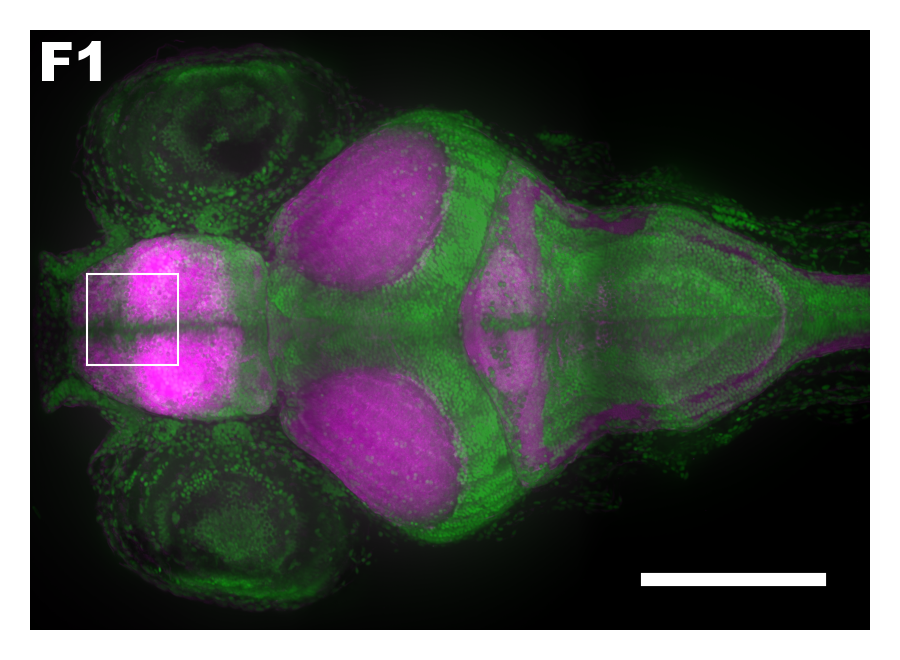

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


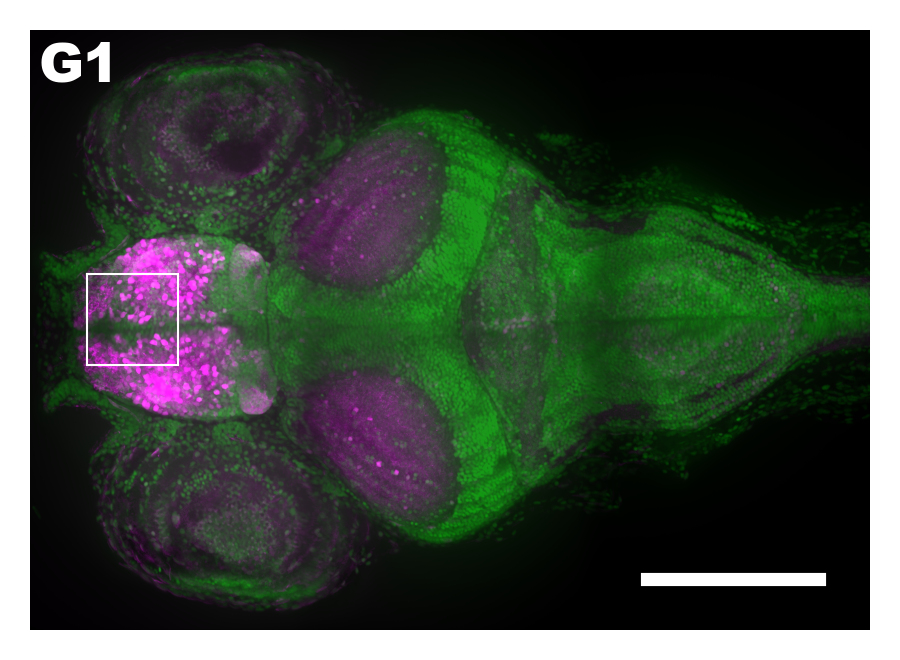

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


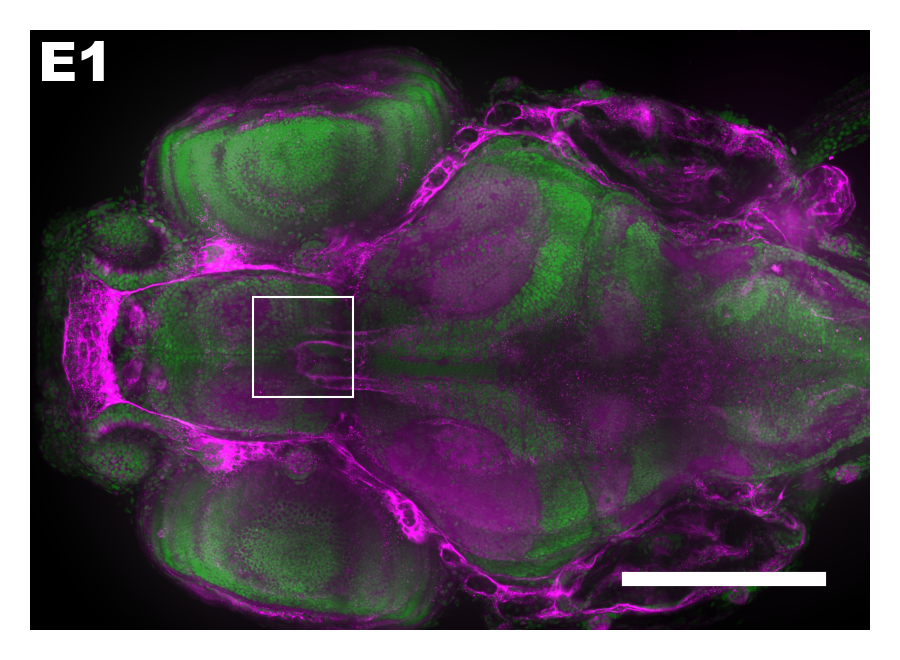

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


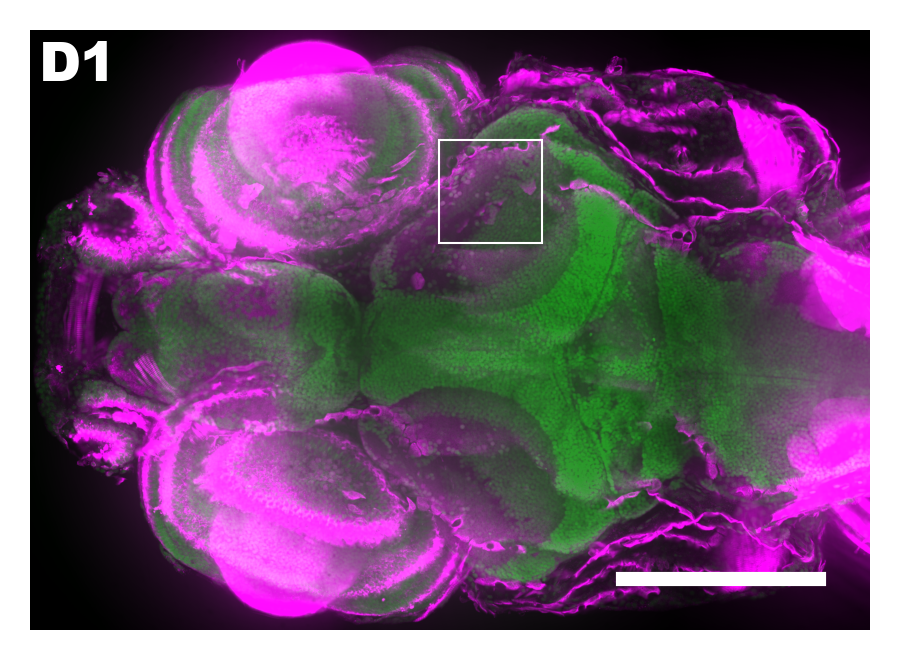

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


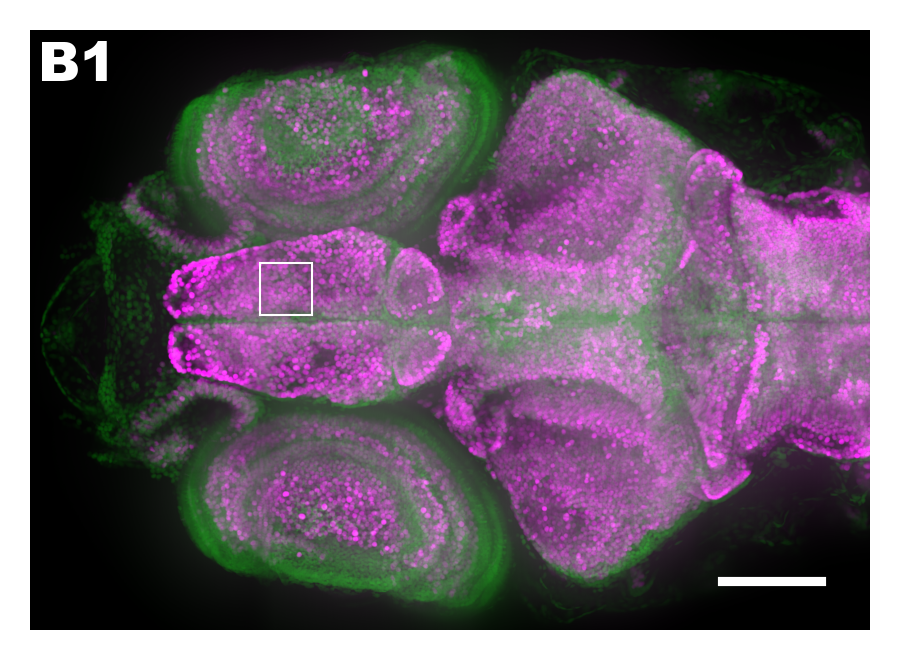

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


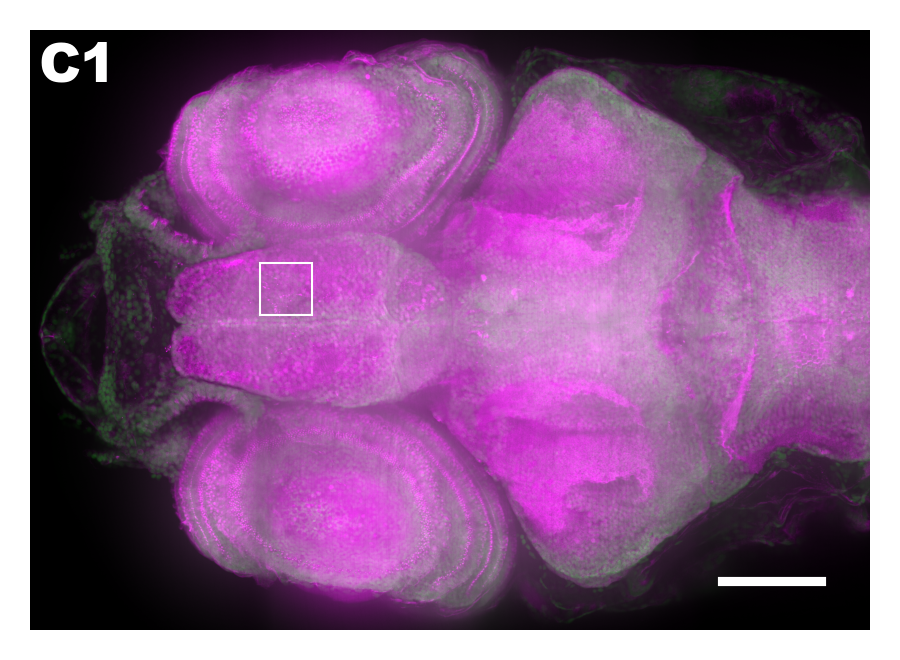

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


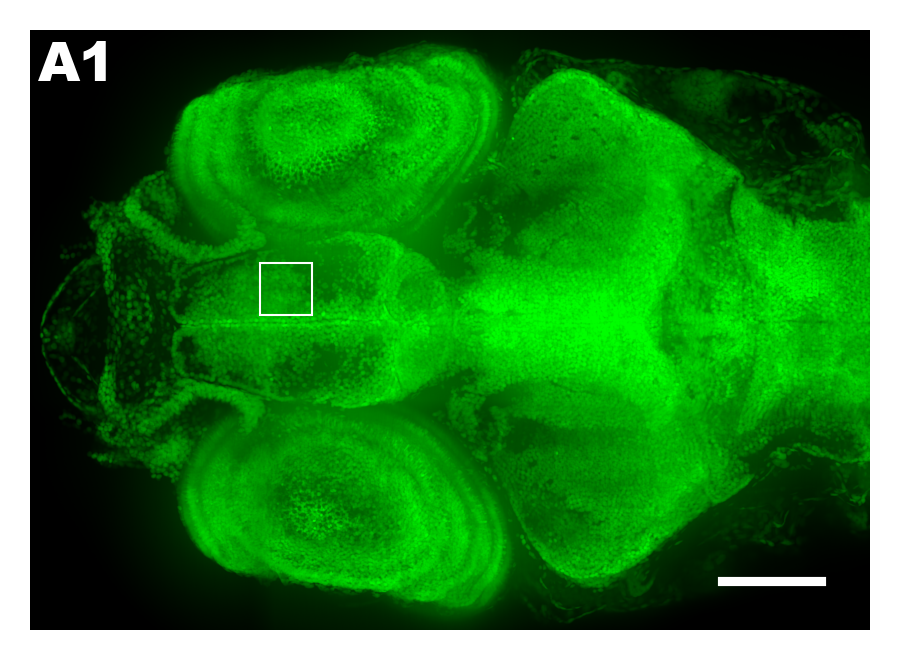

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


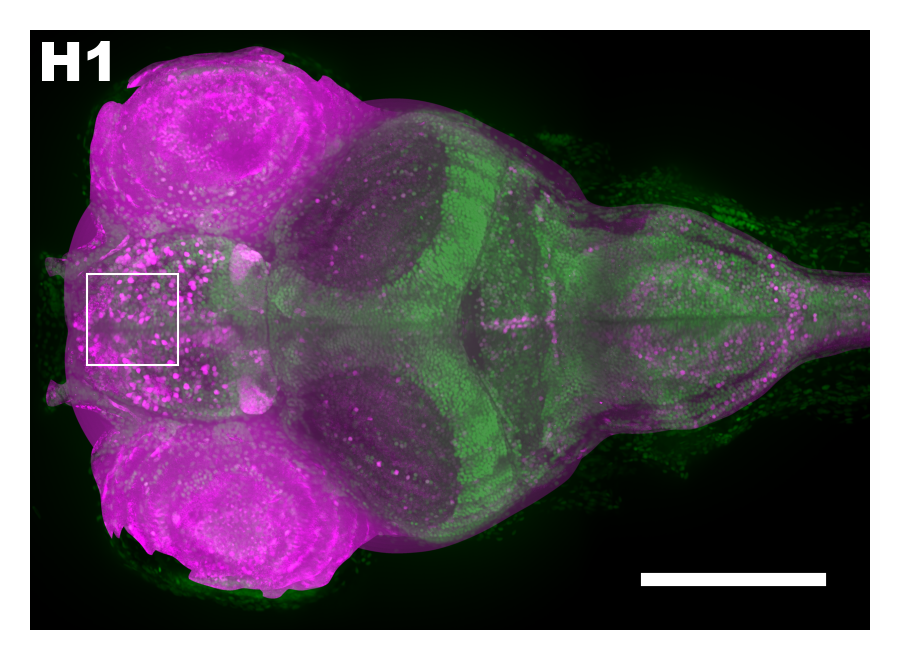

In [370]:
%matplotlib inline
for _ in subfigs_target_overview():
    pass

## ROI Subfigure

In [367]:
def subfigs_roi(subfig_num=2):
    for channel_image_name, ref_image_name in input_image_refs.items():
        image_ref_name = ref_image_name  # for some typing errors
        channel_image = channel_image_dict[channel_image_name]
        ref_image = image_ref_dict[ref_image_name]
        metadata = metadata_dict[ref_image_name]

        pixel_pitch = 1.0 / metadata[X_RESOLUTION_KEY]
        (roi_x, roi_y), roi_slice = roi_loc_dict_xy_plane[ref_image_name]
        roi_slice = roi_slice - 1
        roi_size_pixels = int(roi_size_micron / pixel_pitch)

        area_slice = np.s_[roi_y:roi_y+roi_size_pixels,
                           roi_x:roi_x+roi_size_pixels]

        is_self_ref = channel_image_name == ref_image_name

        channel_im = channel_image[roi_slice].astype(float)
        channel_clim = (
            np.percentile(channel_im[area_slice], min_pcttile / 3),
            np.percentile(channel_im[area_slice], max_pcttile))
        channel_im = np.clip(channel_im, *channel_clim)
        channel_im = (
            (channel_im - channel_clim[0])
            / (channel_clim[1] - channel_clim[0]))

        if is_self_ref:
            ref_im = None
        else:
            ref_im = ref_image[roi_slice].astype(float)
            ref_clim = (
                np.percentile(ref_im[area_slice], min_pcttile / 3),
                np.percentile(ref_im[area_slice], max_pcttile))
            ref_im = np.clip(ref_im, *ref_clim)
            ref_im = (
                (ref_im - ref_clim[0])
                / (ref_clim[1] - ref_clim[0]))

        if is_self_ref:
            zeros = np.zeros_like(channel_im)
            stack_list = [zeros, channel_im, zeros]
        else:
            stack_list = [channel_im, ref_im * ref_mip_attenuation, channel_im]

        rgb_image = np.stack(stack_list, axis=-1)

        fig, ax = plt.subplots(
            1, 1,
            figsize=(fig_height, fig_height),
            gridspec_kw=dict(
                top=1, bottom=0,
                left=0, right=1),
            facecolor=None,
            edgecolor=None,
            frameon=False,
            dpi=300,
        )
        ax.imshow(
            rgb_image,
            extent=metadata[IMAGE_LIMS_KEY],
            origin='lower')
        scalebar = AnchoredSizeBar(
            transform=plt.gca().transData,
            size=20,
            label='',
            loc='lower right',
            pad=1,
            color='white',
            frameon=False,
            size_vertical=1,
            label_top=True)
        ax.add_artist(scalebar)

        square_patch = mpl.patches.Rectangle(
            (roi_x, roi_y),
            roi_size_micron,
            roi_size_micron,
            edgecolor='white',
            facecolor='none',
            lw=0.5,
            zorder=20,
            transform=ax.transData)
        ax.add_artist(square_patch)

        ax.text(
            0.01, 0.98,
            f'{figure_letters[channel_image_name]}{subfig_num:d}',
            transform=ax.transAxes,
            fontsize=13,
            color='white',
            ha='left',
            va='top',
            weight='black')

        roi_x = pixel_pitch * roi_x
        roi_y = pixel_pitch * roi_y

        ax.axis('off')
        ax.set(
            xlim=(roi_x, roi_x + roi_size_micron),
            ylim=(roi_y + roi_size_micron, roi_y)
        )

        yield f'{channel_image_name}_roi', fig


matplotlib.pyplot ( 414): DEBUG : Loaded backend module://matplotlib_inline.backend_inline version unknown.


matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


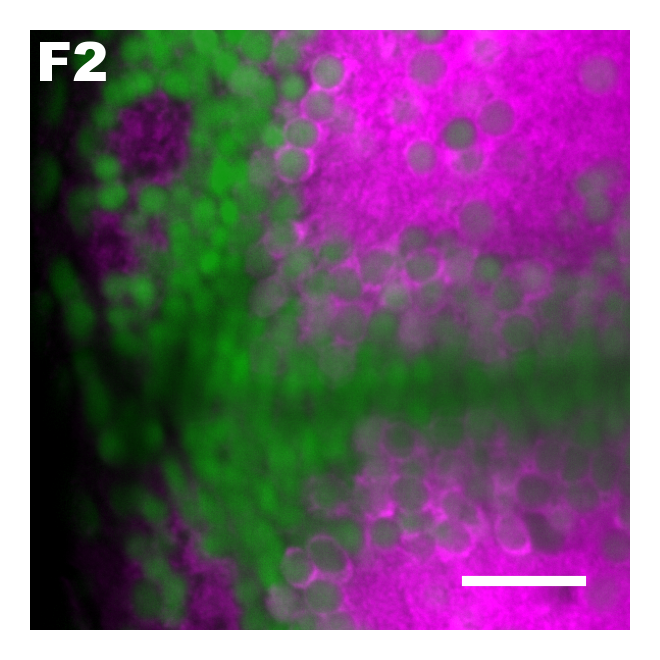

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


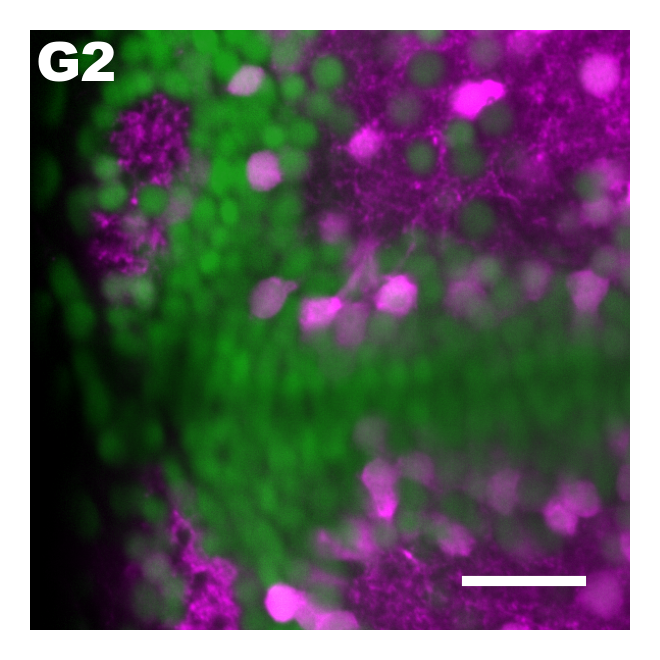

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


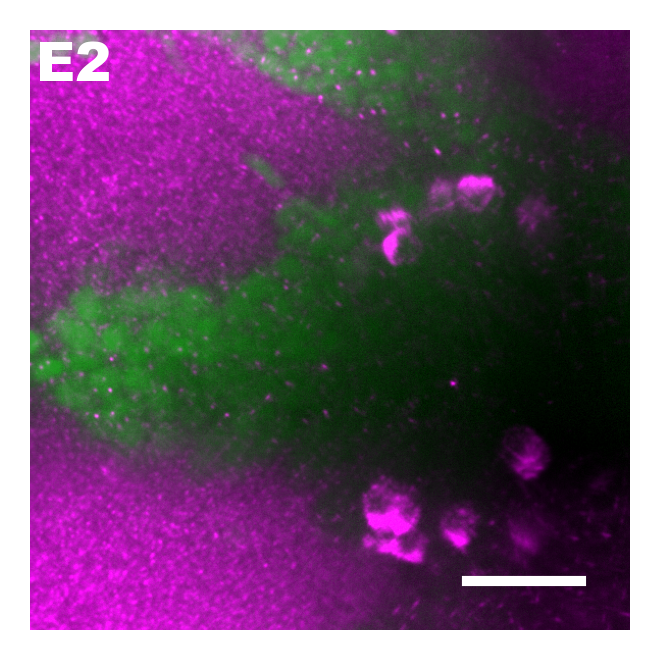

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


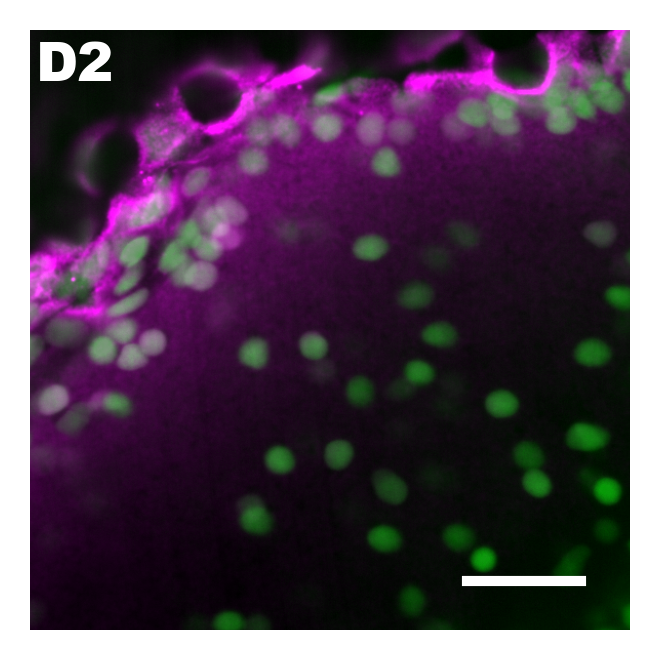

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


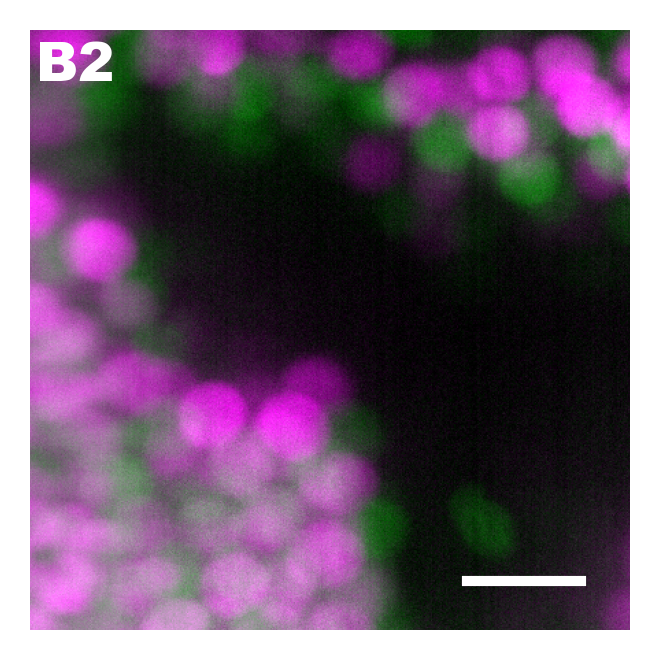

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


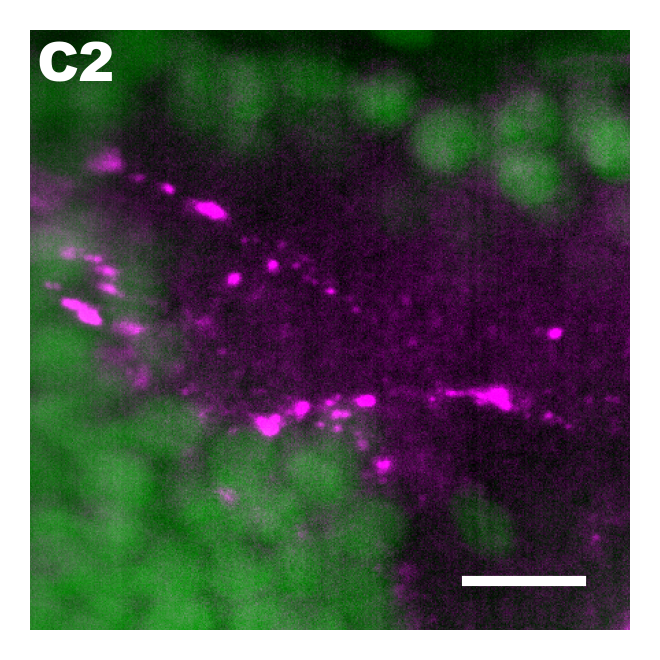

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


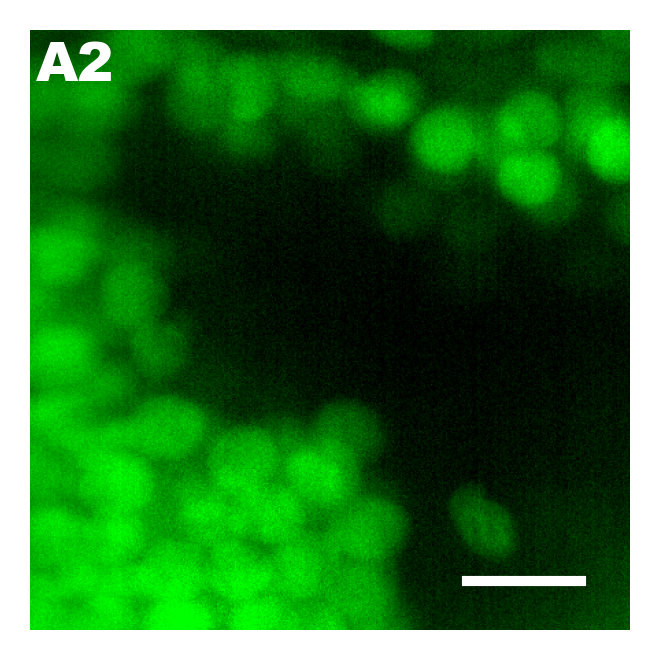

matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved


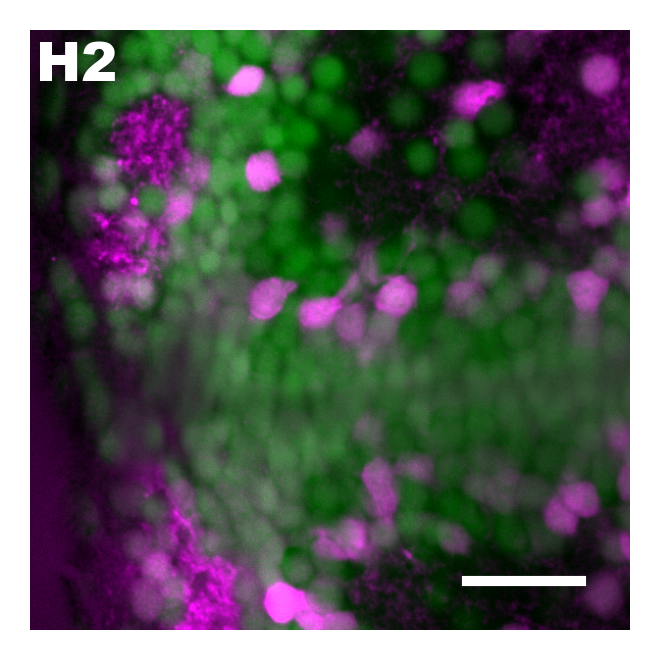

In [368]:
%matplotlib inline
for _ in subfigs_roi():
    pass

## Save Figures

In [371]:
all_subfigs = it.chain(
    subfigs_target_overview(),
    subfigs_roi())

output_dir = os.path.join(input_image_dir, 'exported_figures')
csutils.touchdir(output_dir)

for fig_name, fig in all_subfigs:
    log.info('Saving figure {:s}.', fig_name)
    for ext in ('png', 'pdf'):
        fig_path = os.path.join(output_dir, f'{fig_name}.{ext}')
        fig.savefig(fig_path, dpi=300)
    plt.close(fig)

local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : Saving figure cs-ii-07-a_erk.tif_overview.
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.backends.backend_pdf ( 918): DEBUG : Assigning font /F1 = 'C:\\Windows\\Fonts\\ariblk.ttf'
matplotlib.backends.backend_pdf ( 964): DEBUG : Embedding font C:\Windows\Fonts\ariblk.ttf.
matplotlib.backends.backend_pdf ( 971): DEBUG : Writing TrueType font.
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : Saving figure cs-ii-07-a_perk.tif_overview.
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.axes._base (2986): DEBUG : top of Axes not in the figure, so title not moved
matplotlib.backends.backend_pdf ( 918): DEBUG : Assigning font /F1 = 'C:\\Windows\\Fonts\\ariblk.ttf'
matplotlib.backends.backend_pdf ( 964): DEBUG : Embedding font C:\Windows\Fonts\ariblk.ttf

# Graveyard ☠

In [280]:
perk_image = channel_image_dict[PERK_FNAME]
terk_image = channel_image_dict[TERK_FNAME]
ref_image_name = input_image_refs[PERK_BY_TERK]

slice_index = 0

cutoff_dict = {
    9: 43,
    8: 45,
    7: 47,
    6: 53,
    5: 62,
    4: 72,
    3: 67,
    2: 52,
    1: 46.

}

perk_slice = perk_image[slice_index]
terk_slice = terk_image[slice_index]

perk_min = perk_slice.min()
perk_max = perk_slice.max()
perk_range = perk_max - perk_min
perk_slice = (perk_slice - perk_min) / perk_range

terk_min = terk_slice.min()
terk_max = terk_slice.max()
terk_range = terk_max - terk_min
terk_slice = (terk_slice - terk_min) / terk_range

sum_image = terk_slice
sum_min = sum_image.min()
sum_max = sum_image.max()
sum_range = sum_max - sum_min
sum_image = (sum_image - sum_min) / sum_range

blur_sigma_micron = 8
blur_sigma = blur_sigma_micron * metadata_dict[ref_image_name][X_RESOLUTION_KEY]

blurred_sum_image = scipy.ndimage.gaussian_filter(sum_image, blur_sigma)
blurred_sum_image_min = blurred_sum_image.min()
blurred_sum_image_max = blurred_sum_image.max()
blurred_sum_image_range = blurred_sum_image_max - blurred_sum_image_min
blurred_sum_image = (blurred_sum_image - blurred_sum_image_min) / blurred_sum_image_range


In [281]:
num_zero = (terk_slice == 0).sum()
mask_cutoff = 0
while num_zero > 0:
    mask_cutoff += 1
    cutoff_val = np.percentile(blurred_sum_image, mask_cutoff)
    mask = (blurred_sum_image > cutoff_val)

    num_zero = (terk_slice[mask] == 0).sum()
    log.info('{} : Number of zero values in TERK: {:d}',
             mask_cutoff, num_zero)

output_arr = np.zeros_like(blurred_sum_image)
output_arr[mask] = perk_slice[mask] / terk_slice[mask]
output_min = output_arr.min()
output_max = output_arr.max()
output_range = output_max - output_min
output_arr = (output_arr - output_min) / output_range

local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 1 : Number of zero values in TERK: 7834
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 2 : Number of zero values in TERK: 6604
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 3 : Number of zero values in TERK: 6320
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 4 : Number of zero values in TERK: 6108
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 5 : Number of zero values in TERK: 5936
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 6 : Number of zero values in TERK: 5802
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 7 : Number of zero values in TERK: 5680
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 8 : Number of zero values in TERK: 5565
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 9 : Number of zero values in TERK: 5449
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 10 : Number of zero values in TERK: 5336
local-nb_cs-ii-[multi]_ihc_file_prep (   9): INFO : 11 : Number of zero values 

In [288]:
int(round(metadata_dict[ref_image_name][X_RESOLUTION_KEY] * 8) / 2.0)

23

In [261]:
%matplotlib qt
fig, axs = plt.subplots(3, 3)
axs.flat[0].imshow(
    perk_slice, cmap='cividis', clim=(0, 1))
axs.flat[0].set_title('PERK')
axs.flat[0].axis('off')

axs.flat[1].imshow(
    terk_slice, cmap='cividis', clim=(0, 1))
axs.flat[1].set_title('TERK')
axs.flat[1].axis('off')

axs.flat[2].imshow(
    sum_image, cmap='cividis', clim=(0, 1))
axs.flat[2].set_title('Sum')
axs.flat[2].axis('off')

axs.flat[3].imshow(
    blurred_sum_image, cmap='cividis', clim=(0, 1))
axs.flat[3].set_title('Blurred Sum')
axs.flat[3].axis('off')
plt.show()

axs.flat[4].imshow(
    mask.astype(float),
    cmap='cividis')
axs.flat[4].set_title(f'Thresholdk, {mask_cutoff}%')
axs.flat[4].axis('off')

axs.flat[5].imshow(
    output_arr,
    clim=(0, 1),
    cmap='cividis')
axs.flat[5].set_title('PERK/TERK')
axs.flat[5].axis('off')

matplotlib.pyplot ( 414): DEBUG : Loaded backend QtAgg version 5.15.4.


(-0.5, 5734.5, 3891.5, -0.5)